In [38]:
import cv2
import numpy as np
import sys
import os
import time 
import math
import random
import matplotlib.pyplot as plt


In [39]:

def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh_min=20, thresh_max=110):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    return binary_output

def mag_thresh(image, sobel_kernel=3, mag_thresh=(30, 100)):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    grad_mag = np.sqrt(sobel_x**2 + sobel_y**2)
    scaled_mag = np.uint8(255 * grad_mag / np.max(grad_mag))
    binary_output = np.zeros_like(scaled_mag)
    binary_output[(scaled_mag >= mag_thresh[0]) & (scaled_mag <= mag_thresh[1])] = 1
    return binary_output

def dir_threshold(image, sobel_kernel=3, thresh=(0.7, 1.3)):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    grad_dir = np.arctan2(np.absolute(sobel_y), np.absolute(sobel_x))
    binary_output = np.zeros_like(grad_dir)
    binary_output[(grad_dir >= thresh[0]) & (grad_dir <= thresh[1])] = 1
    return binary_output

def lab_threshold(image, thresh_l=(200, 255), thresh_a=(-128, 128), thresh_b=(-128, 128)):
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2Lab)
    L, a, b = cv2.split(lab)
    
    l_binary = np.zeros_like(L)
    l_binary[(L > thresh_l[0]) & (L <= thresh_l[1])] = 1
    
    a_binary = np.zeros_like(a)
    a_binary[(a > thresh_a[0]) & (a <= thresh_a[1])] = 1
    
    b_binary = np.zeros_like(b)
    b_binary[(b > thresh_b[0]) & (b <= thresh_b[1])] = 1
    
    return l_binary, a_binary, b_binary

def hls_threshold(image, thresh_l=(160,255), thres_s=(180,255)):
    hls = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)
    H, L, S = cv2.split(hls)
    
    s_binary = np.zeros_like(S)
    s_binary[(S > thres_s[0]) & (S <= thres_s[1])] = 1
    
    l_binary = np.zeros_like(L)
    l_binary[(L > thresh_l[0]) & (L <= thresh_l[1])] = 1
    
    return l_binary, s_binary

# Combine the gradient and color-based thresholds
def combined_gradient(image):
    ksize = 3  # Sobel kernel size for better gradient measurements

    # Apply the gradient thresholds
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh_min=20, thresh_max=110)
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh_min=20, thresh_max=110)
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(90, 200))
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.2, 0.4))
    
    # Apply the color thresholds
    l_binary_lab, _, _ = lab_threshold(image)
    print('l_binary_lab')
    
    # Combine the binary thresholds
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) | (grady == 1)) | (mag_binary == 1) | (dir_binary == 1) | (l_binary_lab == 1) ] = 1
    print('combined')
    
    return combined

# plot all the images 1 by figure 
def plot_combined_thresholds(images):
    for i, image in enumerate(images):
        combined = combined_gradient(image)
        fig, axs = plt.subplots(1, 2, figsize=(20, 10))
        # normalize the image
        image = cv2.normalize(image, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axs[0].set_title('Original Image')
        axs[0].axis('off')
        axs[1].imshow(combined, cmap='gray')
        axs[1].set_title('Combined Thresholds')
        axs[1].axis('off')
        plt.show()


img_paths = sorted(['data/Test_Images/' + img for img in os.listdir('data/Test_Images/')])
print(img_paths)

# Read images
images = [cv2.imread(img) for img in img_paths]

time_ini = time.time()
for image in images:
    combined = combined_gradient(image)
time_end = time.time()
print('Time elapsed: ', time_end - time_ini, 's')



['data/Test_Images/TEST_0.png', 'data/Test_Images/TEST_1.png', 'data/Test_Images/TEST_2.png', 'data/Test_Images/TEST_4.png', 'data/Test_Images/TEST_5.png', 'data/Test_Images/TEST_6.png', 'data/Test_Images/TEST_7.png', 'data/Test_Images/TEST_8.png', 'data/Test_Images/TEST_9.png']
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
Time elapsed:  6.699583053588867 s


Point 1 selected: (934, 2012)
Point 2 selected: (1639, 1598)
Point 3 selected: (2278, 1557)
Point 4 selected: (3270, 2070)
4 points selected. Press 'q' to continue.
Point 1 selected: (1229, 1966)
Point 2 selected: (1778, 1525)
Point 3 selected: (2299, 1504)
Point 4 selected: (3412, 1972)
4 points selected. Press 'q' to continue.
Point 1 selected: (1205, 1894)
Point 2 selected: (1869, 1569)
Point 3 selected: (2321, 1571)
Point 4 selected: (3224, 2060)
4 points selected. Press 'q' to continue.
Point 1 selected: (1098, 1966)
Point 2 selected: (1726, 1540)
Point 3 selected: (2354, 1564)
Point 4 selected: (3330, 2089)
4 points selected. Press 'q' to continue.
Point 1 selected: (1066, 1936)
Point 2 selected: (1718, 1507)
Point 3 selected: (2270, 1515)
Point 4 selected: (3341, 2046)
4 points selected. Press 'q' to continue.
Point 1 selected: (857, 2012)
Point 2 selected: (1828, 1531)
Point 3 selected: (2225, 1523)
Point 4 selected: (3282, 2058)
4 points selected. Press 'q' to continue.
Point 

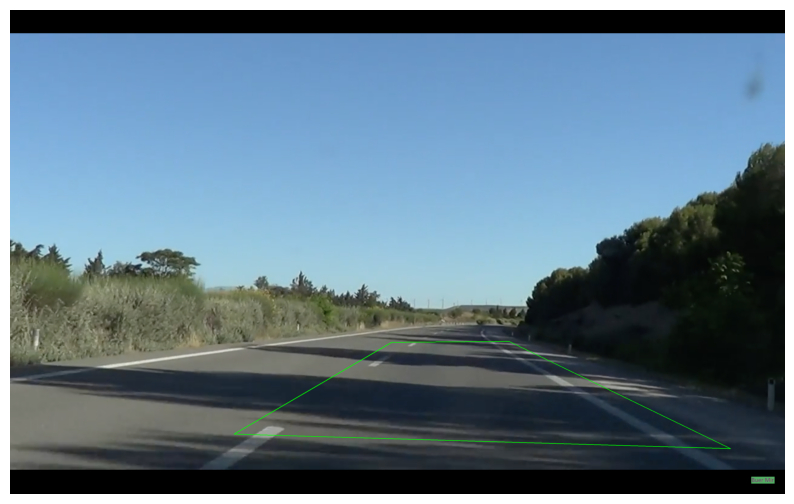

In [119]:
# Lista para almacenar los puntos seleccionados
selected_points = []

# Función para manejar la selección de puntos en la imagen
def select_points(event, x, y, flags, param):
    global selected_points
    if event == cv2.EVENT_LBUTTONDOWN:
        # Al hacer clic izquierdo, agregamos el punto seleccionado a la lista
        if len(selected_points) < 4:  # Solo permitir 4 puntos
            selected_points.append((x, y))
            print(f"Point {len(selected_points)} selected: ({x}, {y})")
        if len(selected_points) == 4:
            print("4 points selected. Press 'q' to continue.")

# Función para seleccionar los puntos en la imagen
def select_points_on_image(image):
    global selected_points
    selected_points = []  # Limpiar puntos seleccionados antes de comenzar

    # Crear una ventana para mostrar la imagen
    cv2.imshow("Select 4 Points", image)
    cv2.setMouseCallback("Select 4 Points", select_points)

    # Esperar a que el usuario seleccione los 4 puntos
    while len(selected_points) < 4:
        key = cv2.waitKey(1) & 0xFF
        if key == ord('q'):  # Permitir salir si presionas 'q'
            break

    cv2.destroyAllWindows()

    # Devolver los puntos seleccionados
    return selected_points


# Select the ROI on the diferent images AND SELECT the ROI as a mean of the 4 points selected
# THE ORDER OF SELECTION IS bottom left, top left, bottom right, top right

roi_points = []
for image in images:
    roi_point = select_points_on_image(image)
    roi_points.append(roi_point)
    
# do the mean for the 4 points selected for each image
roi_points = np.mean(roi_points, axis=0)
print(roi_points)




if len(roi_points) == 4:
    # Los puntos se asumen como el orden: p1, p2, p4, p3 (base inferior a base superior)
    pts = np.array(roi_points, dtype=int)

    # Dibujar el ROI (polígono) en la imagen
    image_with_roi = image.copy()
    cv2.polylines(image_with_roi, [pts], isClosed=True, color=(0, 255, 0), thickness=2)

    # Mostrar la imagen con el ROI seleccionado
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(image_with_roi, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

else:
    print("No se seleccionaron suficientes puntos.")





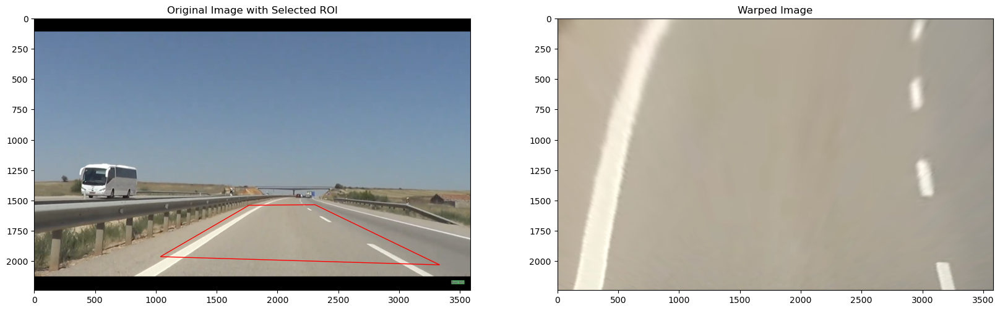

l_binary_lab
combined


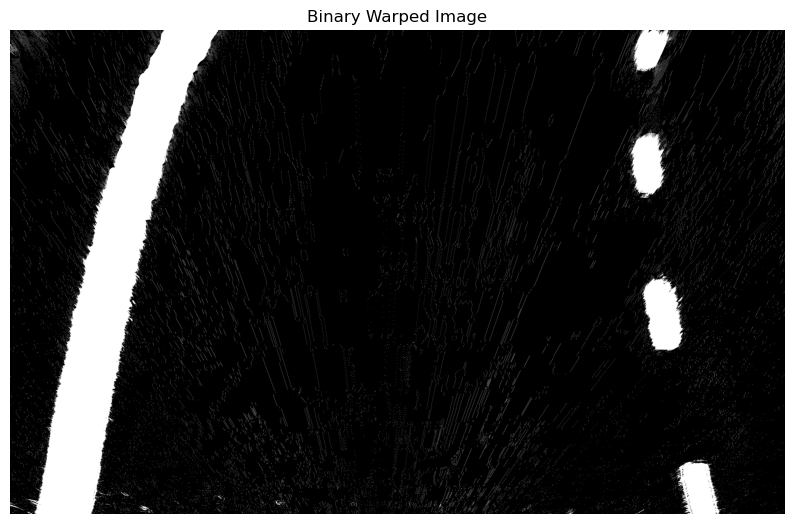

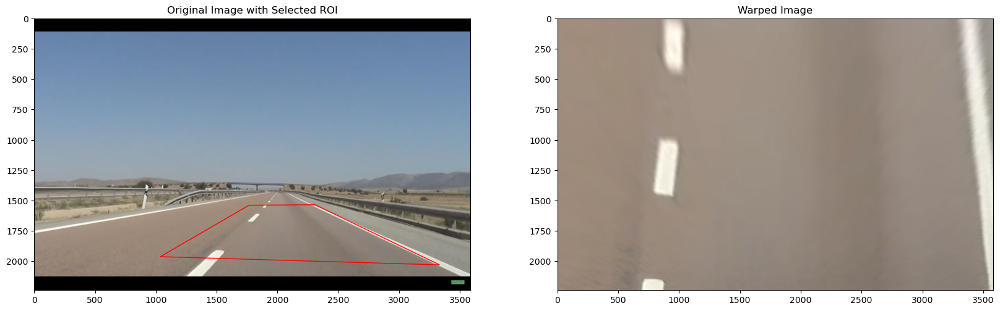

l_binary_lab
combined


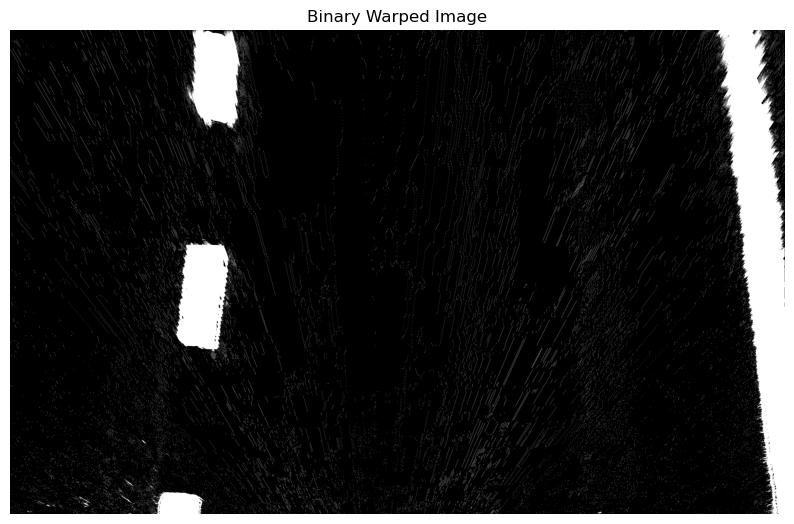

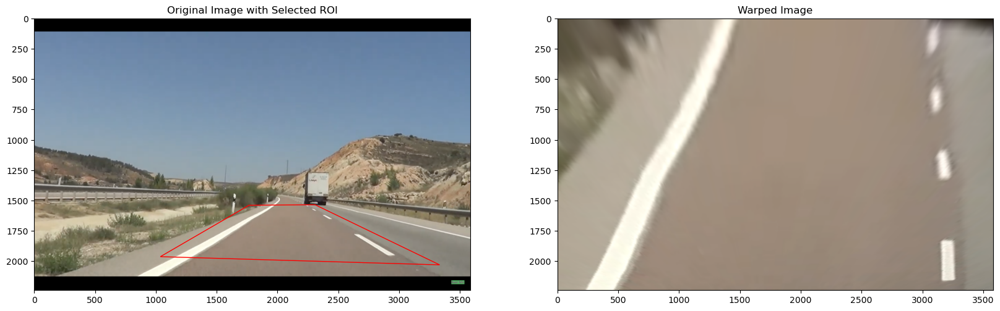

l_binary_lab
combined


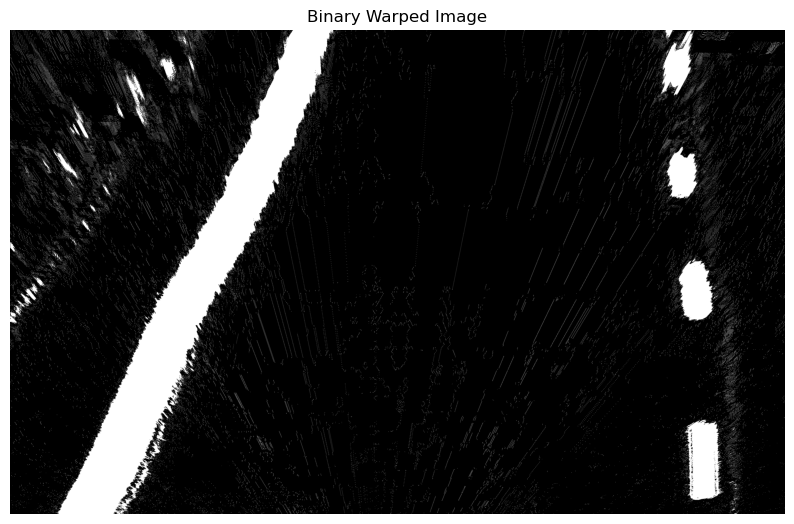

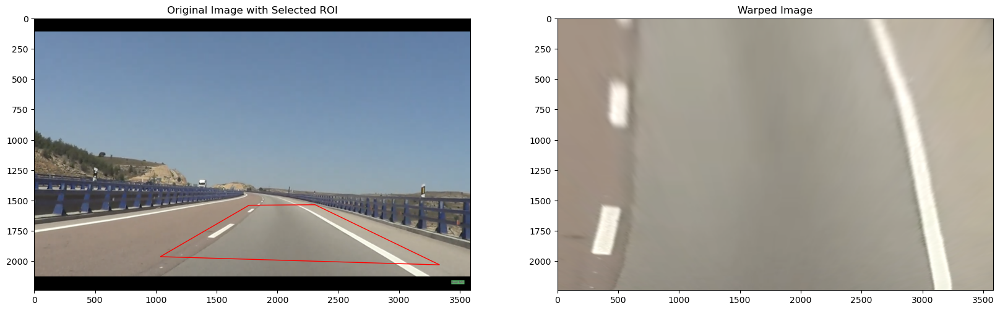

l_binary_lab
combined


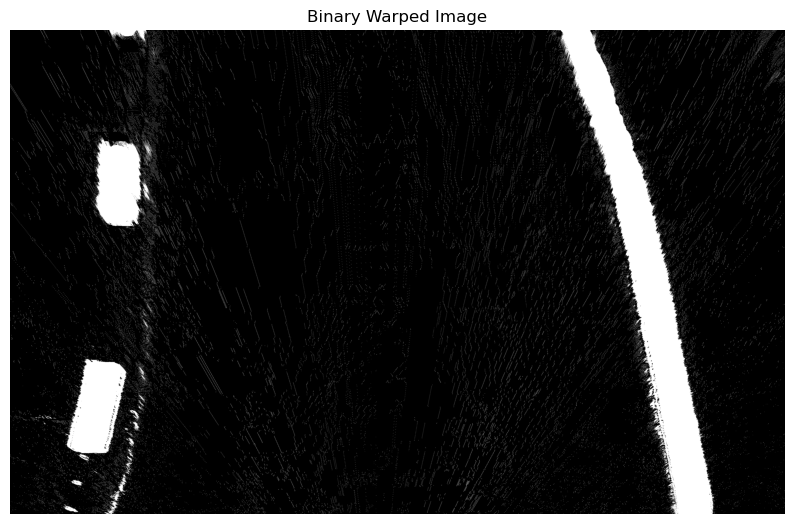

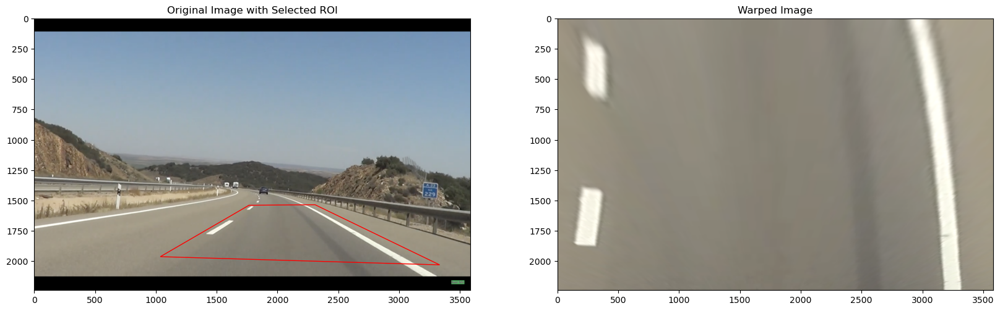

l_binary_lab
combined


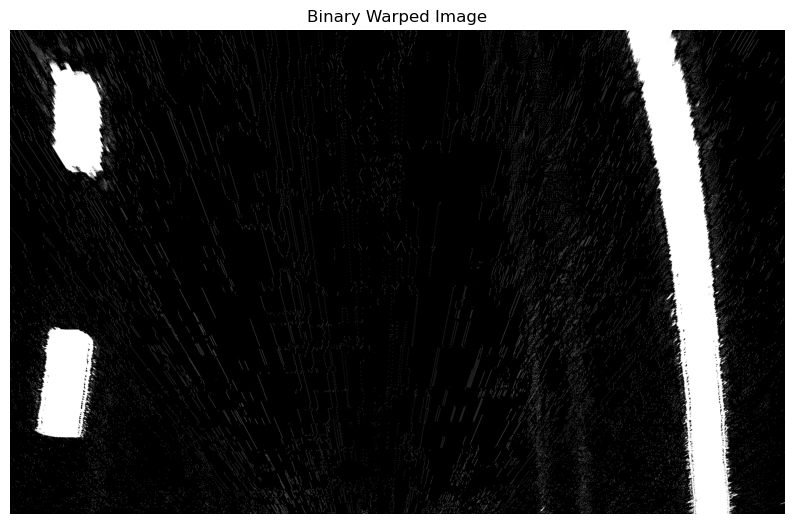

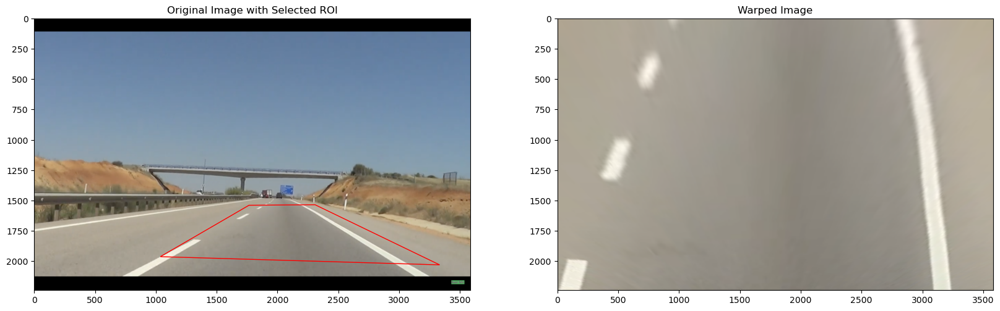

l_binary_lab
combined


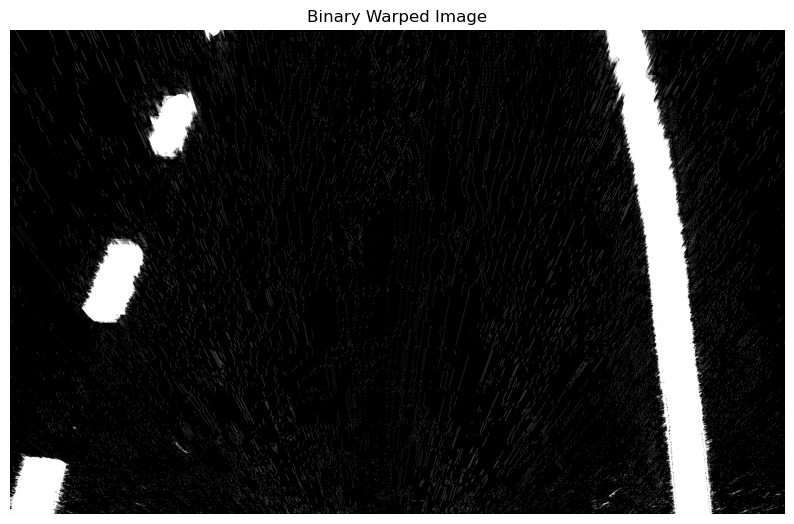

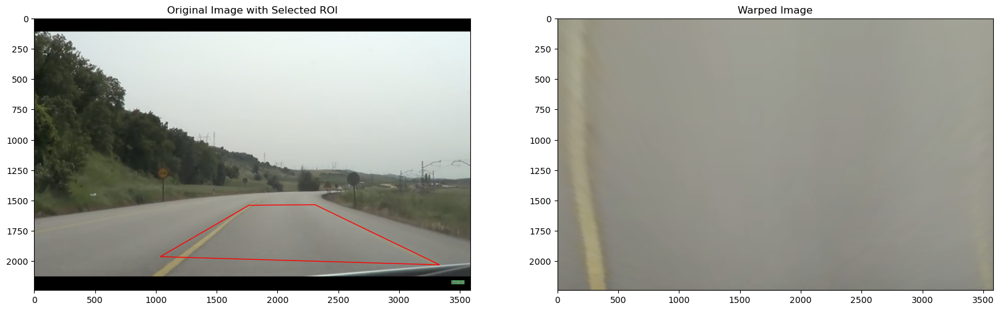

l_binary_lab
combined


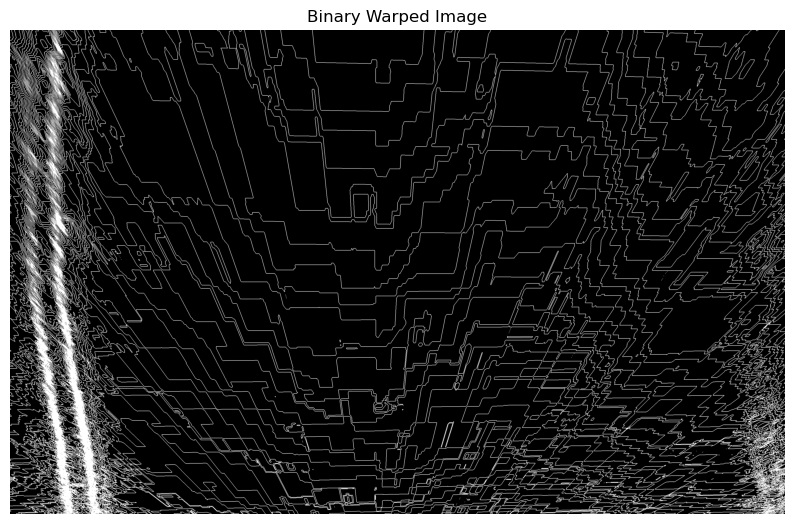

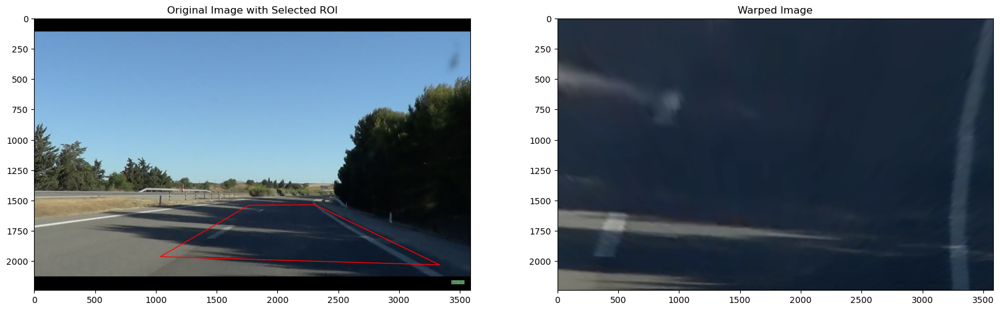

l_binary_lab
combined


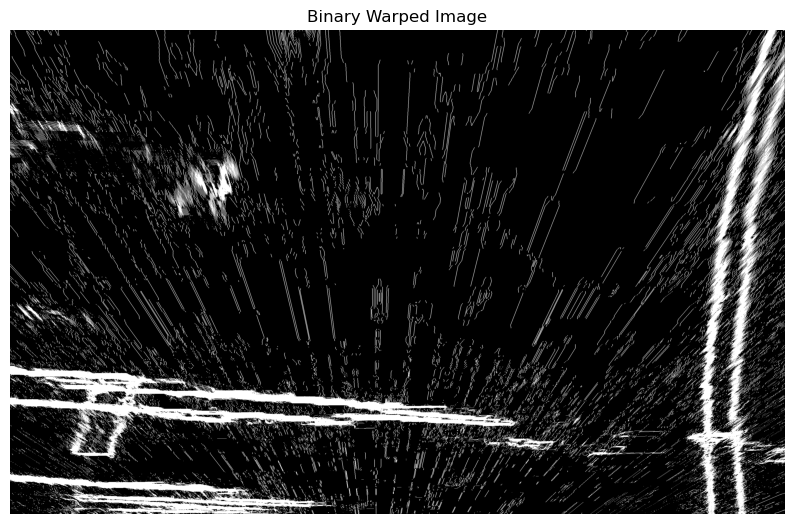

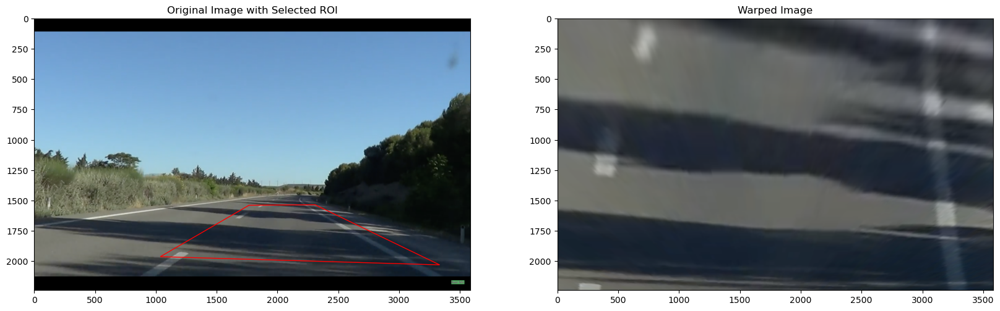

l_binary_lab
combined


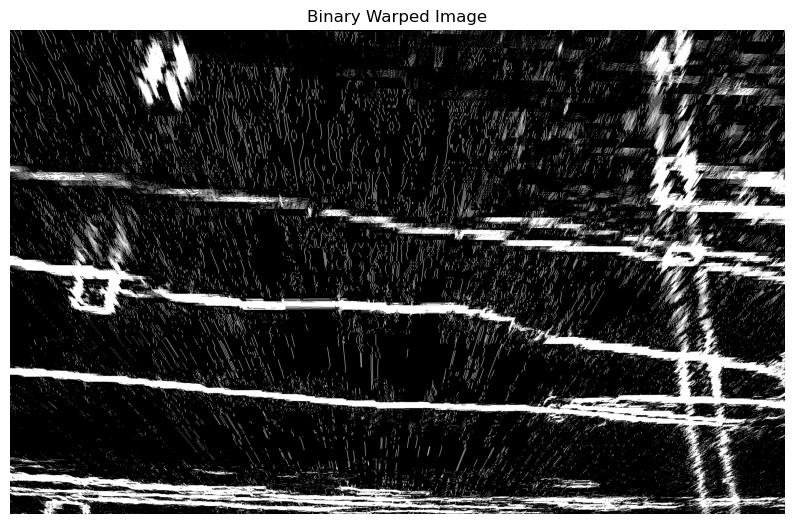

In [171]:
def apply_perspective_transform(image, roi_points):
    # Definir los 4 puntos de destino para la transformación
    height, width = image.shape[:2]
    dst_points = np.array([[0, height], [0, 0], [width, 0], [width, height]], dtype=np.float32)
    src_points = np.array(roi_points, dtype=np.float32)

    # Calcular la matriz de transformación de perspectiva
    M = cv2.getPerspectiveTransform(src_points, dst_points)

    # Aplicar la transformación de perspectiva
    warped_image = cv2.warpPerspective(image, M, (width, height))

    return warped_image, dst_points, src_points



def plot_ROI_and_perspective_transform(image, roi_points):
    if len(roi_points) == 4:
        warped_image, dst, src = apply_perspective_transform(image, roi_points)

        # Visualizar la imagen original con los puntos seleccionados
        plt.figure(figsize=(20, 10))
        plt.subplot(1, 2, 1)
        plt.title("Original Image with Selected ROI")
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        poly = plt.Polygon(roi_points, closed=True, fill=False, color='#FF0000')
        plt.gca().add_patch(poly)

        # Visualizar la imagen transformada
        plt.subplot(1, 2, 2)
        plt.title("Warped Image")
        plt.imshow(cv2.cvtColor(warped_image, cv2.COLOR_BGR2RGB))
        plt.show()

    else:
        print("No se seleccionaron suficientes puntos.")

    binary_warped = combined_gradient(warped_image)
 
    plt.figure(figsize=(10, 10))
    plt.imshow(binary_warped, cmap='gray')
    plt.title("Binary Warped Image")
    plt.axis('off')
    plt.show()


for image in images:
    plot_ROI_and_perspective_transform(image, roi_points)   



Now we are going to generete an histogram from the binary wrapped image. This helps us to find and locate the left and rigth edges of the wapped edges. AS we center the ROI in the lane, we can use this information to divide the histogram in two and find the left and right edges of the lane, wich correspond to the peaks of the histogram as we are using a binary image.

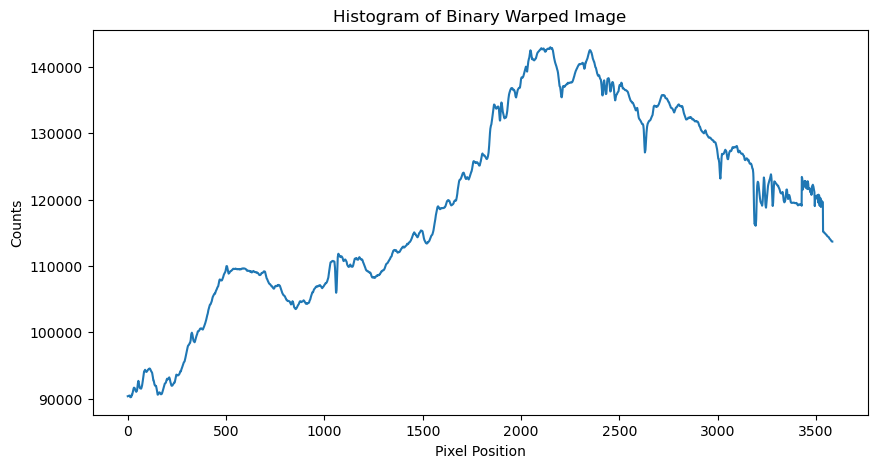

In [121]:
def calculate_histogram(binary_warped):
    """Calcula el histograma de la mitad inferior de una imagen binaria."""
    return np.sum(binary_warped[binary_warped.shape[0]//2:, :], axis=0)

def find_lane_base(histogram):
    """Encuentra las bases de las líneas izquierda y derecha usando el histograma."""
    midpoint = int(histogram.shape[0] // 2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint # We add the midpoint to get the offset
    return leftx_base, rightx_base


histogram = calculate_histogram(binary_warped)

plt.figure(figsize=(10, 5))
plt.plot(histogram)
plt.title("Histogram of Binary Warped Image")
plt.xlabel("Pixel Position")
plt.ylabel("Counts")
plt.show()



# We can see the two peaks in the histogram, which correspond to the base of the left and right lanes

Now we have the right and left edges of the lane, we can use the sliding window technique to find the pixels that belong to the lane. We will use a window of 100 pixels to slide from the bottom to the top of the image. We will use the pixels that are inside the window to find the pixels that belong to the lane. We will use the pixels that belong to the lane to fit a second order polynomial to the lane. This polynomial will be used to draw the lane on the image.

First approach, but too slow to be used in real time.
DONT RUN

In [ ]:

def perform_sliding_window(binary_image, base_left, base_right, num_windows=10, window_margin=60, min_pixels=40):
    height_window = binary_image.shape[0] // num_windows

    pixels_y, pixels_x = binary_image.nonzero()

    current_left = base_left
    current_right = base_right

    left_indices = []
    right_indices = []
    detected_windows = []

    for win in range(num_windows):
        y_top = binary_image.shape[0] - (win + 1) * height_window
        y_bottom = binary_image.shape[0] - win * height_window

        x_left_range = (current_left - window_margin, current_left + window_margin)
        x_right_range = (current_right - window_margin, current_right + window_margin)

        detected_windows.append(((current_left, y_bottom), (current_right, y_bottom)))

        left_pixels_in_window = []
        for px, py in zip(pixels_x, pixels_y):
            if (y_top <= py < y_bottom) and (x_left_range[0] <= px < x_left_range[1]):
                left_pixels_in_window.append((px, py))
        
        right_pixels_in_window = []
        for px, py in zip(pixels_x, pixels_y):
            if (y_top <= py < y_bottom) and (x_right_range[0] <= px < x_right_range[1]):
                right_pixels_in_window.append((px, py))
        
        valid_left_indices = [np.where((pixels_x == px) & (pixels_y == py))[0][0] for px, py in left_pixels_in_window]
        valid_right_indices = [np.where((pixels_x == px) & (pixels_y == py))[0][0] for px, py in right_pixels_in_window]

        left_indices.append(valid_left_indices)
        right_indices.append(valid_right_indices)
        
        if len(valid_left_indices) > min_pixels:
            current_left = int(np.mean([pixels_x[idx] for idx in valid_left_indices]))
        if len(valid_right_indices) > min_pixels:
            current_right = int(np.mean([pixels_x[idx] for idx in valid_right_indices]))

    left_indices = np.concatenate(left_indices) if len(left_indices) > 0 else []
    right_indices = np.concatenate(right_indices) if len(right_indices) > 0 else []

    x_left = pixels_x[left_indices]
    y_left = pixels_y[left_indices]
    x_right = pixels_x[right_indices]
    y_right = pixels_y[right_indices]

    left_curve = np.polyfit(y_left, x_left, 2) if len(x_left) > 0 else None
    right_curve = np.polyfit(y_right, x_right, 2) if len(x_right) > 0 else None

    return left_curve, right_curve, left_indices, right_indices, detected_windows

def visualize_results(binary_image, left_fit, right_fit, window_coords):
    y_vals = np.linspace(0, binary_image.shape[0] - 1, binary_image.shape[0])
    x_left_fit = x_right_fit = None

    if left_fit is not None:
        x_left_fit = left_fit[0] * y_vals ** 2 + left_fit[1] * y_vals + left_fit[2]
    if right_fit is not None:
        x_right_fit = right_fit[0] * y_vals ** 2 + right_fit[1] * y_vals + right_fit[2]

    plt.imshow(binary_image, cmap='gray')
    
    # Dibujar ventanas
    for (left, right) in window_coords:
        left_rect = plt.Rectangle((left[0] - 60, left[1] - 25), 120, 50, edgecolor='cyan', fill=False, linewidth=2)
        right_rect = plt.Rectangle((right[0] - 60, right[1] - 25), 120, 50, edgecolor='orange', fill=False, linewidth=2)
        plt.gca().add_patch(left_rect)
        plt.gca().add_patch(right_rect)
    
    # Dibujar polinomios ajustados
    if x_left_fit is not None:
        plt.plot(x_left_fit, y_vals, color='lime', label='Carril Izquierdo')
    if x_right_fit is not None:
        plt.plot(x_right_fit, y_vals, color='magenta', label='Carril Derecho')
    
    plt.title("Sliding Windows y Ajuste de Carriles")
    plt.legend()
    plt.show()

def measure_lane_width(window_coords):
    """Calcula el ancho promedio del carril en píxeles basado en las ventanas detectadas."""
    lane_widths = [abs(left[0] - right[0]) for left, right in window_coords]
    avg_width = np.mean(lane_widths)
    return avg_width

# Ejemplo de uso

for image in images: 
    binary = combined_gradient(image)
    binary_warped, dst, src = apply_perspective_transform(binary, roi_points)
    histogram = calculate_histogram(binary_warped)
    left_base, right_base = find_lane_base(histogram)
    left_fit, right_fit, left_indices, right_indices, windows = perform_sliding_window(binary_warped, left_base, right_base)
    visualize_results(binary_warped, left_fit, right_fit, windows)
    lane_width = measure_lane_width(windows)
    print("Ancho promedio del carril:", lane_width)
    


l_binary_lab
combined


KeyboardInterrupt: 

Second aproach, faster and more efficient. The change is in the way we find the pixels that belong to the lane. We will use the pixels that are inside the window to find the pixels that belong to the lane. We will use the pixels that belong to the lane to fit a second order polynomial to the lane. This polynomial will be used to draw the lane on the image.

l_binary_lab
combined


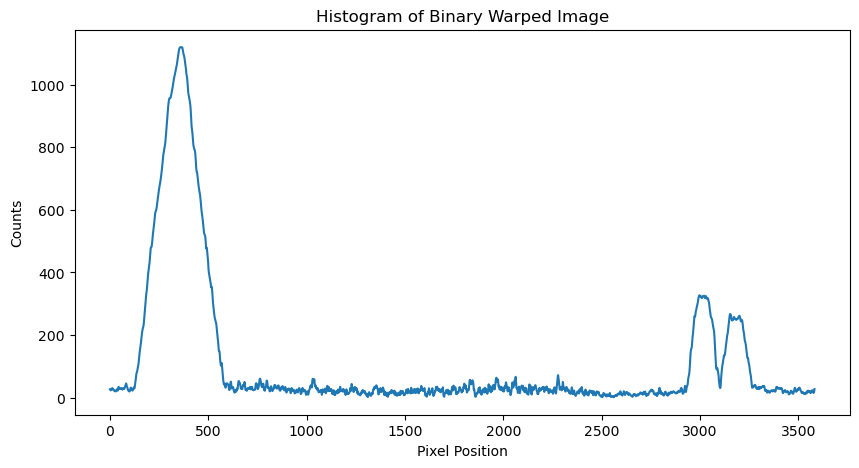

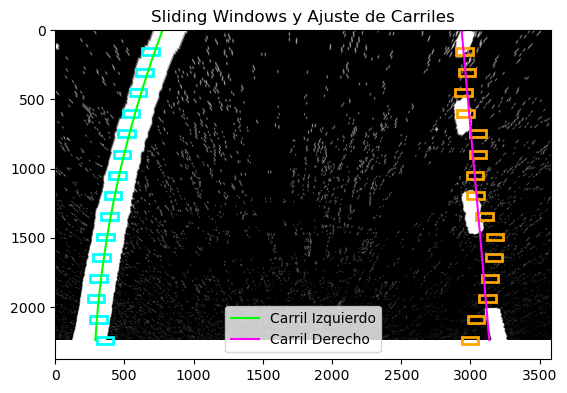

Ancho promedio del carril: 2603.9333333333334
l_binary_lab
combined


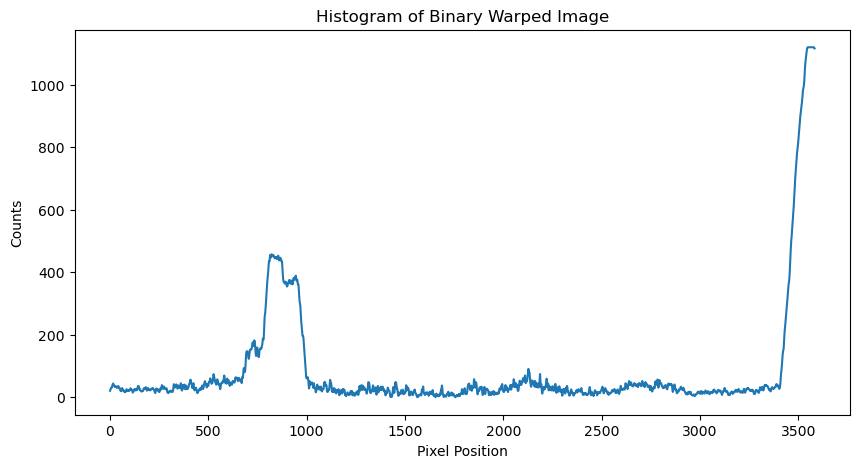

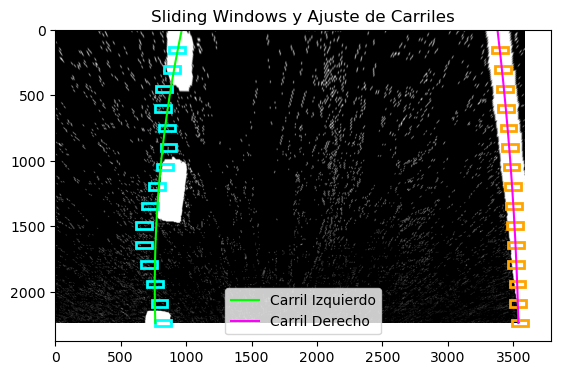

Ancho promedio del carril: 2687.2
l_binary_lab
combined


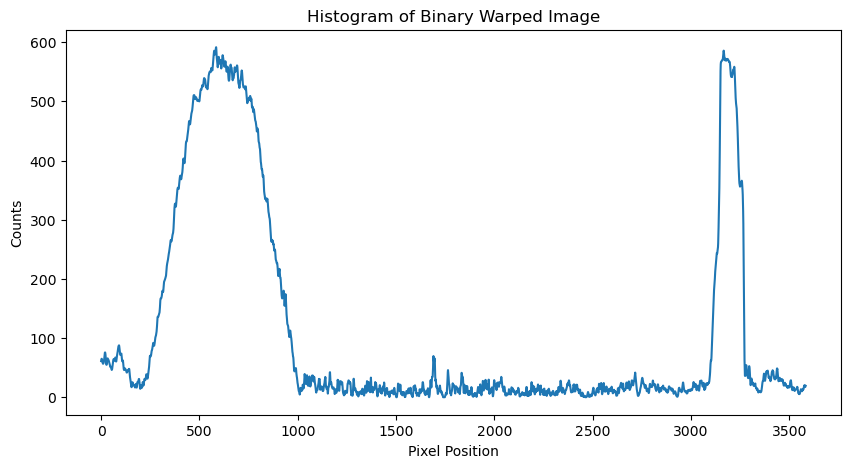

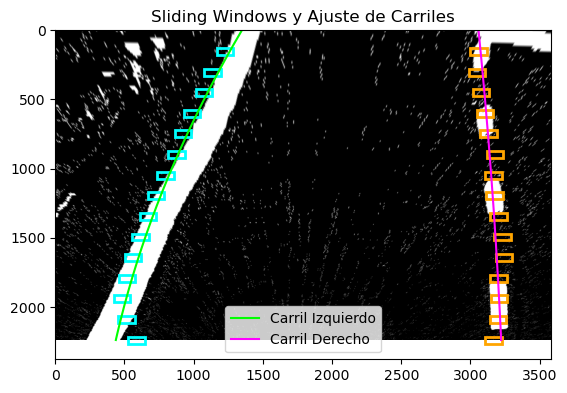

Ancho promedio del carril: 2379.4666666666667
l_binary_lab
combined


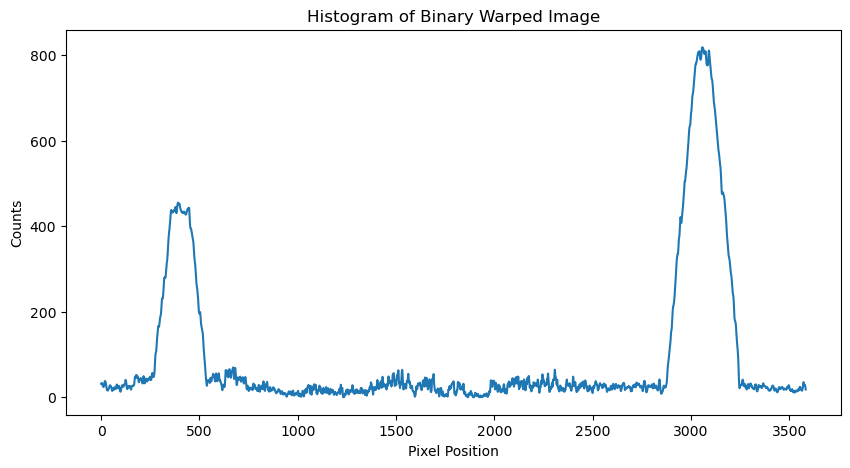

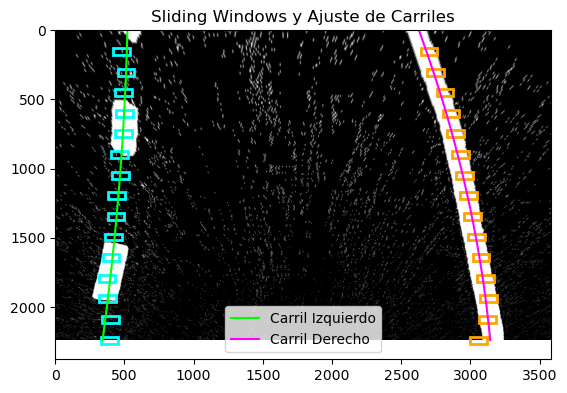

Ancho promedio del carril: 2519.133333333333
l_binary_lab
combined


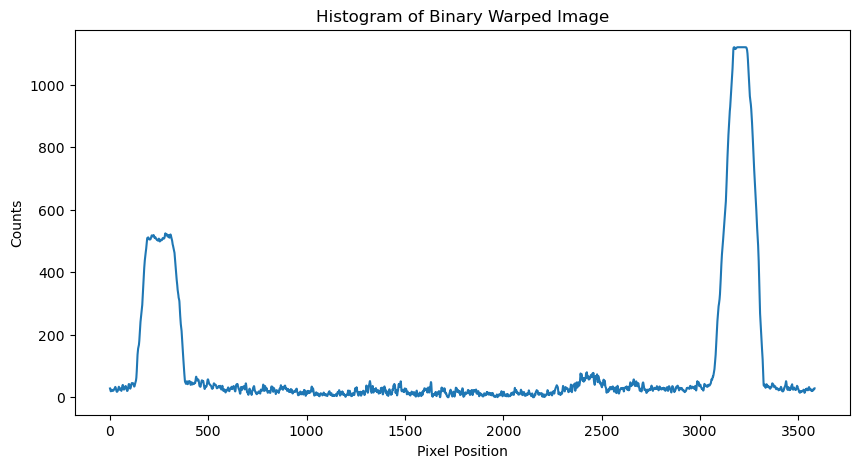

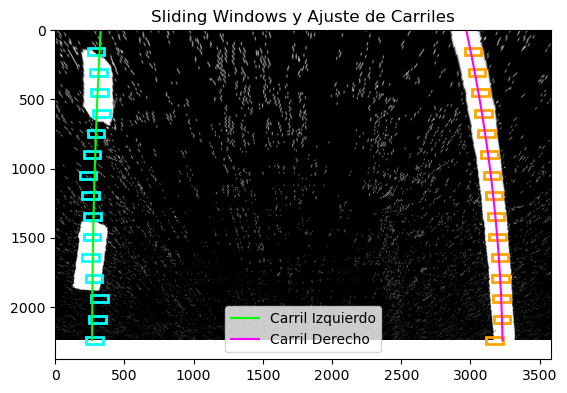

Ancho promedio del carril: 2864.4
l_binary_lab
combined


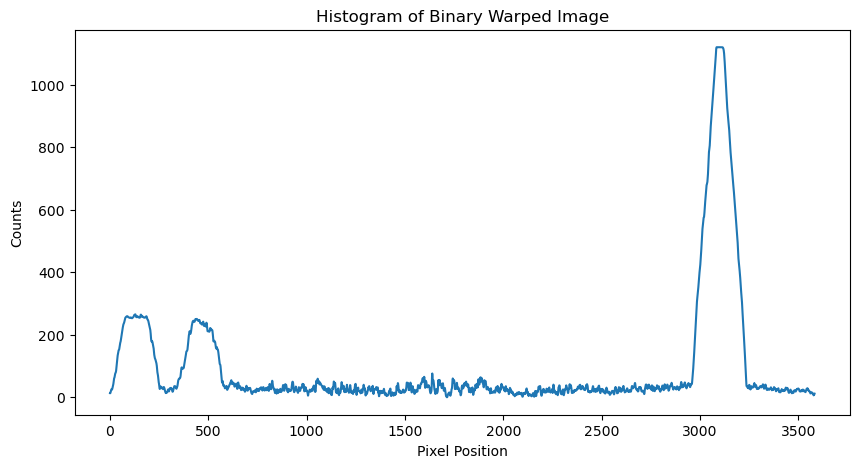

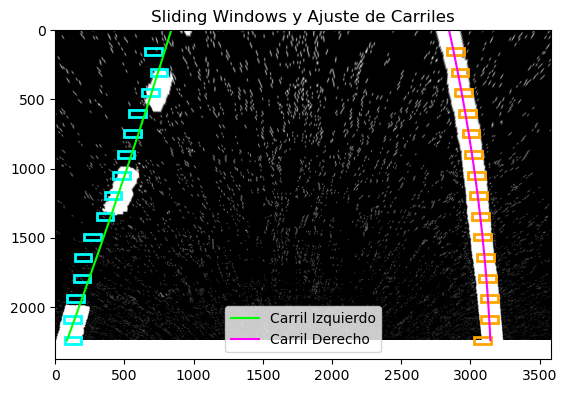

Ancho promedio del carril: 2633.3333333333335
l_binary_lab
combined


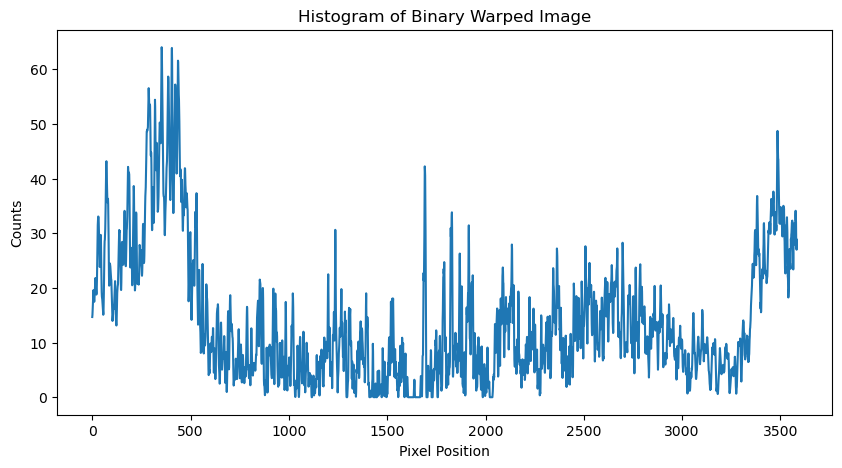

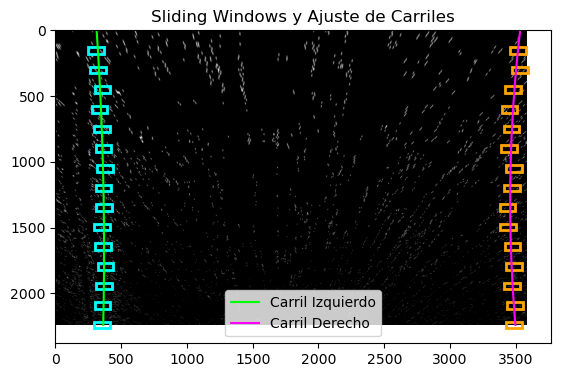

Ancho promedio del carril: 3118.733333333333
l_binary_lab
combined


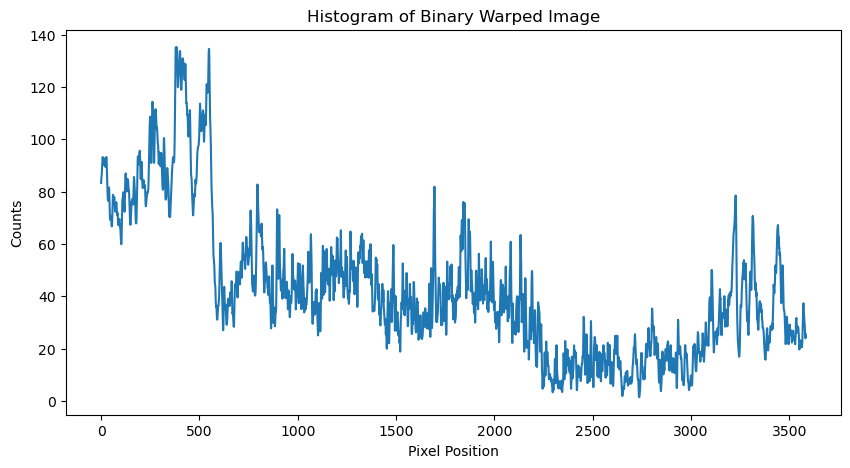

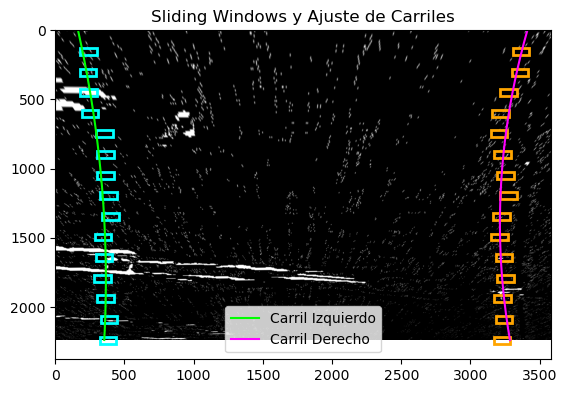

Ancho promedio del carril: 2921.0666666666666
l_binary_lab
combined


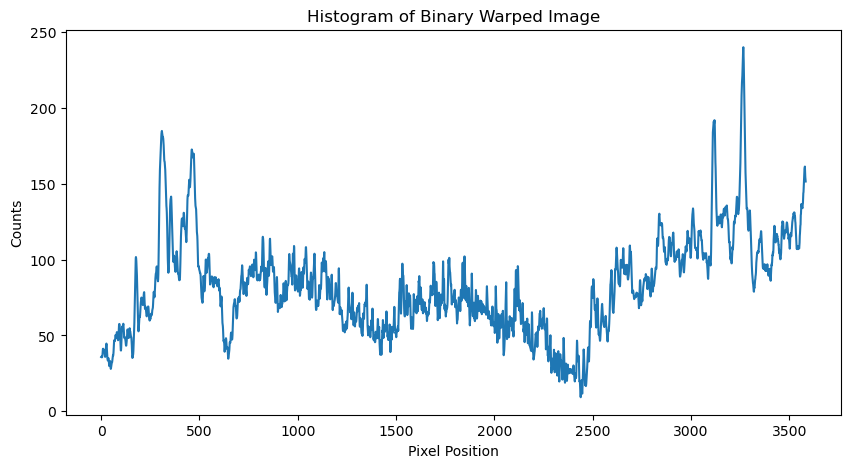

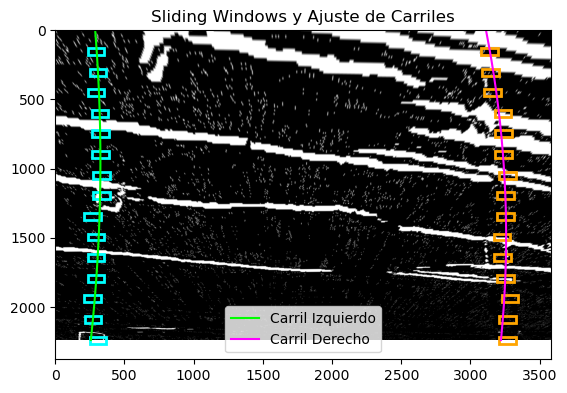

Ancho promedio del carril: 2927.5333333333333


In [170]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def perform_sliding_window(binary_image, base_left, base_right, num_windows=15, window_margin= 150, min_pixels=300):
    """
    Implementa el algoritmo del sliding window para detectar los puntos de carril.
    
    Parameters:
        binary_image: Imagen binaria transformada (con perspectiva corregida).
        base_left, base_right: Coordenadas base iniciales de los carriles izquierdo y derecho.
        num_windows: Número de ventanas a utilizar.
        window_margin: Ancho de cada ventana en píxeles.
        min_pixels: Umbral mínimo de píxeles para recenter una ventana.
    
    Returns:
        left_curve, right_curve: Polinomios ajustados para los carriles izquierdo y derecho.
        left_pixels, right_pixels: Índices de los píxeles pertenecientes a cada carril.
        detected_windows: Lista de coordenadas centrales de las ventanas detectadas.
    """
    # Altura de cada ventana en píxeles
    height_window = binary_image.shape[0] // num_windows

    # Obtener las posiciones de los píxeles activados
    pixels_y, pixels_x = binary_image.nonzero()

    # Posición actual de las ventanas
    current_left = base_left
    current_right = base_right

    # Listas para guardar los píxeles del carril y los centros de las ventanas
    left_indices = []
    right_indices = []
    detected_windows = []

    for win in range(num_windows):
        # Límites de las ventanas
        y_top = binary_image.shape[0] - (win + 1) * height_window
        y_bottom = binary_image.shape[0] - win * height_window
        x_left_low = current_left - window_margin
        x_left_high = current_left + window_margin
        x_right_low = current_right - window_margin
        x_right_high = current_right + window_margin

        # Agregar las coordenadas centrales de las ventanas
        detected_windows.append(((current_left, y_bottom), (current_right, y_bottom)))

        # Encontrar píxeles dentro de cada ventana
        valid_left = ((pixels_y >= y_top) & (pixels_y < y_bottom) &
                      (pixels_x >= x_left_low) & (pixels_x < x_left_high)).nonzero()[0]
        valid_right = ((pixels_y >= y_top) & (pixels_y < y_bottom) &
                       (pixels_x >= x_right_low) & (pixels_x < x_right_high)).nonzero()[0]

        # Guardar los índices de los píxeles
        left_indices.append(valid_left)
        right_indices.append(valid_right)

        # Actualizar la posición de las ventanas si se detectan suficientes píxeles
        if len(valid_left) > min_pixels:
            current_left = int(np.mean(pixels_x[valid_left]))
        if len(valid_right) > min_pixels:
            current_right = int(np.mean(pixels_x[valid_right]))

    # Concatenar índices de píxeles
    left_indices = np.concatenate(left_indices)
    right_indices = np.concatenate(right_indices)

    # Extraer las coordenadas de los píxeles de cada carril
    x_left = pixels_x[left_indices]
    y_left = pixels_y[left_indices]
    x_right = pixels_x[right_indices]
    y_right = pixels_y[right_indices]

    # Ajustar polinomios a los píxeles detectados
    left_curve = np.polyfit(y_left, x_left, 2) if len(x_left) > 0 else None
    right_curve = np.polyfit(y_right, x_right, 2) if len(x_right) > 0 else None

    return left_curve, right_curve, left_indices, right_indices, detected_windows

def visualize_results(binary_image, left_fit, right_fit, window_coords):
    """
    Dibuja las ventanas del sliding window y los polinomios ajustados.
    
    Parameters:
        binary_image: Imagen binaria de entrada.
        left_fit, right_fit: Coeficientes de los polinomios ajustados.
        window_coords: Coordenadas de las ventanas del sliding window.
    """
    y_vals = np.linspace(0, binary_image.shape[0] - 1, binary_image.shape[0])
    x_left_fit = x_right_fit = None

    if left_fit is not None:
        x_left_fit = left_fit[0] * y_vals ** 2 + left_fit[1] * y_vals + left_fit[2]
    if right_fit is not None:
        x_right_fit = right_fit[0] * y_vals ** 2 + right_fit[1] * y_vals + right_fit[2]

    plt.imshow(binary_image, cmap='gray')
    
    # Dibujar ventanas en funcion del size de la imagen
    for (left, right) in window_coords:
        left_rect = plt.Rectangle((left[0] - 60, left[1] - 25), 120, 50, edgecolor='cyan', fill=False, linewidth=2)
        right_rect = plt.Rectangle((right[0] - 60, right[1] - 25), 120, 50, edgecolor='orange', fill=False, linewidth=2)
        plt.gca().add_patch(left_rect)
        plt.gca().add_patch(right_rect)
    
    # Dibujar polinomios ajustados
    if x_left_fit is not None:
        plt.plot(x_left_fit, y_vals, color='lime', label='Carril Izquierdo')
    if x_right_fit is not None:
        plt.plot(x_right_fit, y_vals, color='magenta', label='Carril Derecho')
    
    plt.title("Sliding Windows y Ajuste de Carriles")
    plt.legend()
    plt.show()

def measure_lane_width(window_coords):
    """Calcula el ancho promedio del carril en píxeles basado en las ventanas detectadas."""
    lane_widths = [abs(left[0] - right[0]) for left, right in window_coords]
    avg_width = np.mean(lane_widths)
    return avg_width


for image in images: 
    image = cv2.medianBlur(image, 5)
    binary = combined_gradient(image)
    binary_warped, dst, src = apply_perspective_transform(binary, roi_points)
    # eliminamos el ruido de la imagen
    histogram = calculate_histogram(binary_warped)
    #plot the histogram
    plt.figure(figsize=(10, 5))
    plt.plot(histogram)
    plt.title("Histogram of Binary Warped Image")
    plt.xlabel("Pixel Position")
    plt.ylabel("Counts")
    plt.show()

    left_base, right_base = find_lane_base(histogram)
    left_fit, right_fit, left_indices, right_indices, windows = perform_sliding_window(binary_warped, left_base, right_base)
    visualize_results(binary_warped, left_fit, right_fit, windows)
    lane_width = measure_lane_width(windows)
    print("Ancho promedio del carril:", lane_width)


l_binary_lab
combined


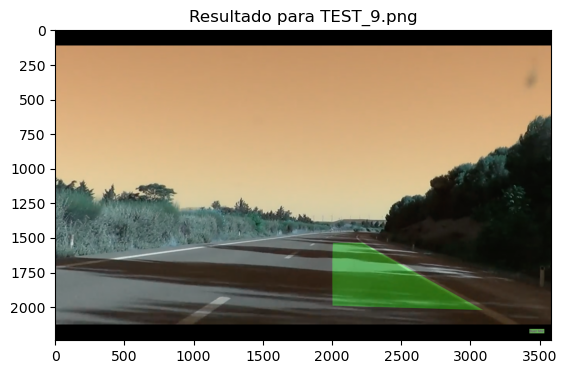

l_binary_lab
combined


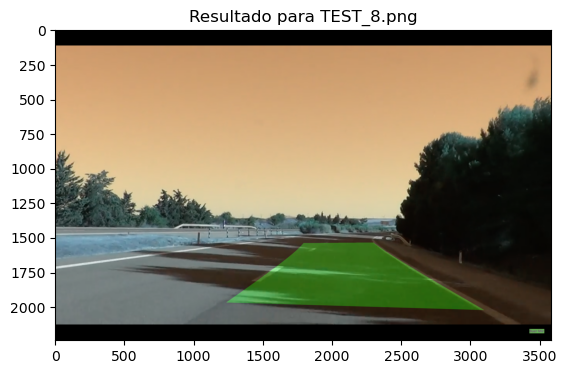

l_binary_lab
combined


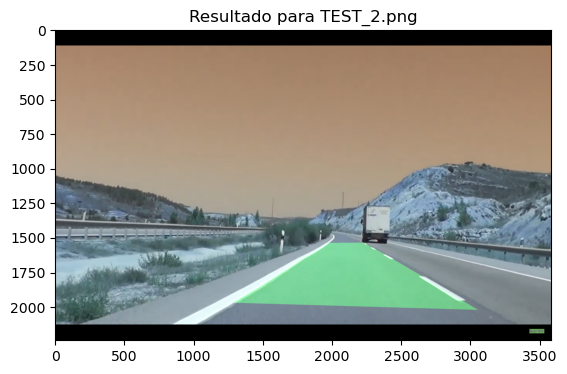

l_binary_lab
combined


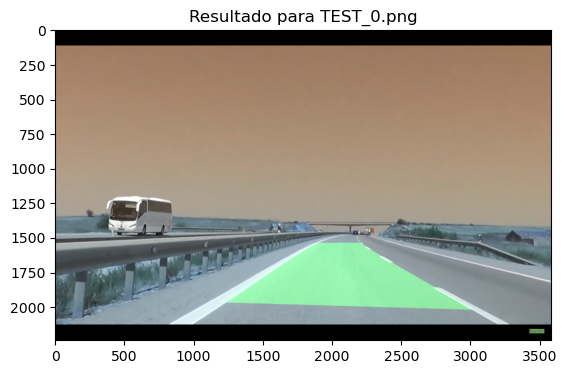

l_binary_lab
combined


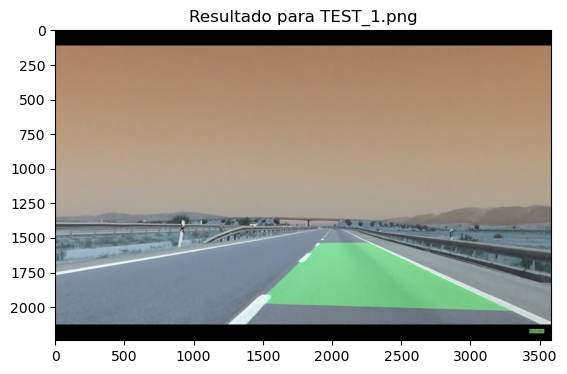

l_binary_lab
combined


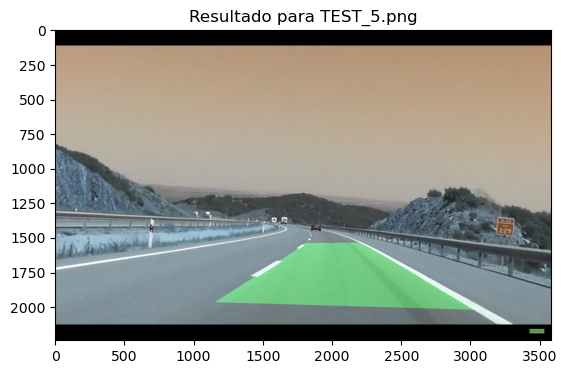

l_binary_lab
combined


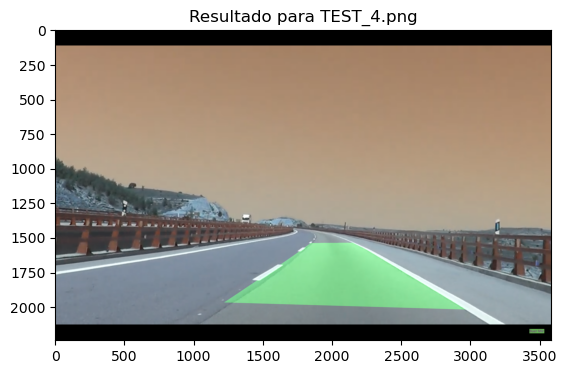

l_binary_lab
combined


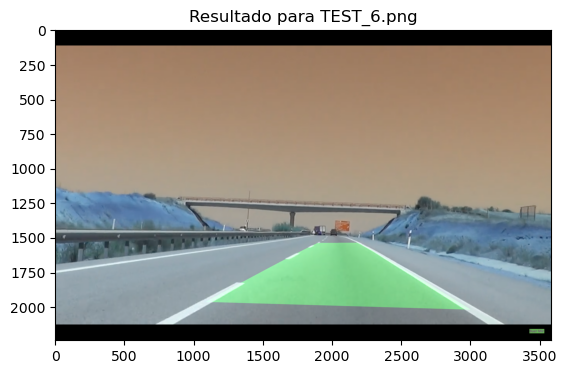

l_binary_lab
combined


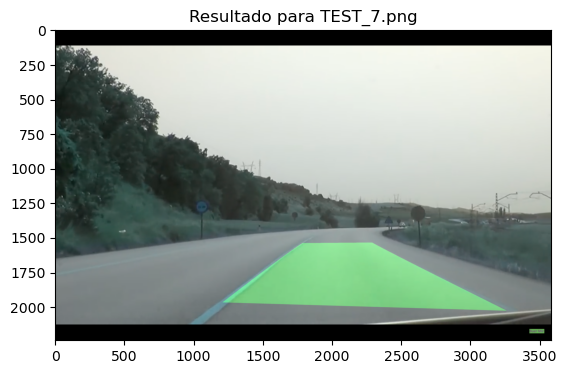

In [140]:
# Leer todas las imágenes del directorio
image_folder = 'data/Test_Images/'
image_files = [f for f in os.listdir(image_folder) if f.endswith('.jpg') or f.endswith('.png')]

# Procesar cada imagen
for image_file in image_files:
    image_path = os.path.join(image_folder, image_file)
    image = cv2.imread(image_path)

    # Asegúrate de realizar la binarización y transformación previa de la imagen
    binary_warped = combined_gradient(apply_perspective_transform(image, roi_points)[0])

    # Obtener la información de los carriles
    histogram_data = np.sum(binary_warped[binary_warped.shape[0] // 2:, :], axis=0)
    base_left, base_right = np.argmax(histogram_data[:binary_warped.shape[1] // 2]), np.argmax(histogram_data[binary_warped.shape[1] // 2:]) + binary_warped.shape[1] // 2

    left_fit, right_fit, _, _, windows = perform_sliding_window(binary_warped, base_left, base_right)

    # Crear la imagen de los carriles sobre la original
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2] if left_fit is not None else []
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2] if right_fit is not None else []

    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    Minv = cv2.getPerspectiveTransform(dst, src)

    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0]))
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)

    # Mostrar el resultado para cada imagen
    plt.imshow(result)
    plt.title(f'Resultado para {image_file}')
    plt.show()

Now that we have the results that we want, we will use downsizing to make the image smaller and faster to process. We will use the same techniques to find the lane in the downsized image and then we will use the polynomial that we found to draw the lane on the original image.



## Downsizing the image

Now we are going to perform the same operations that we did before, but in a downsized image. This will make the process faster and we will be able to use it in real time.

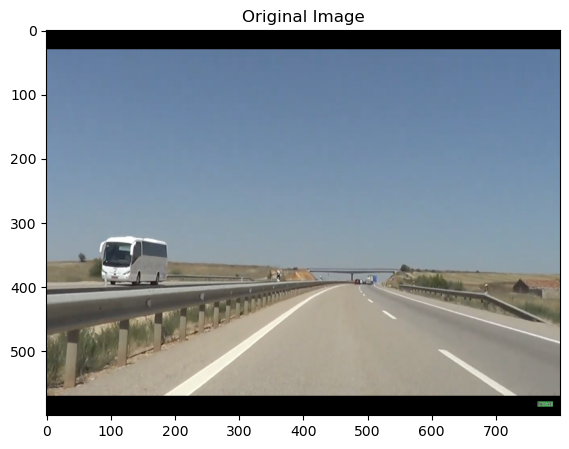

l_binary_lab
combined


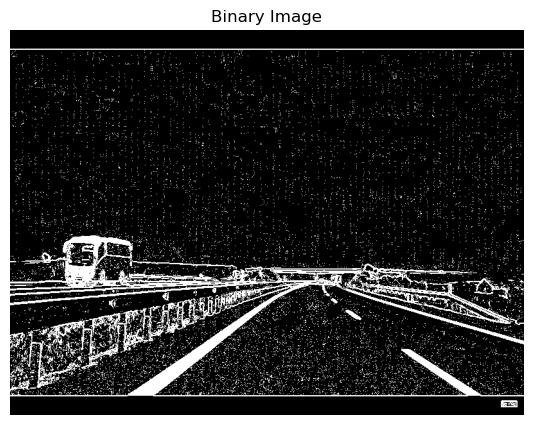

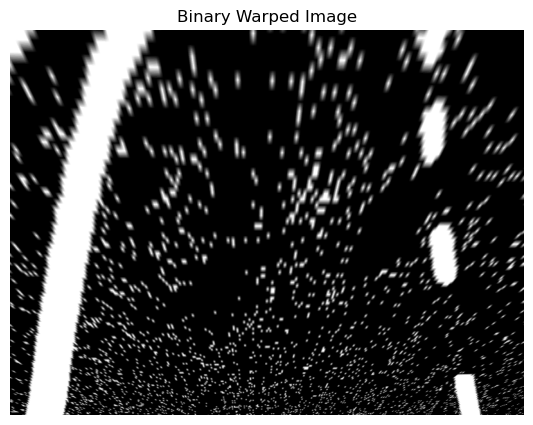

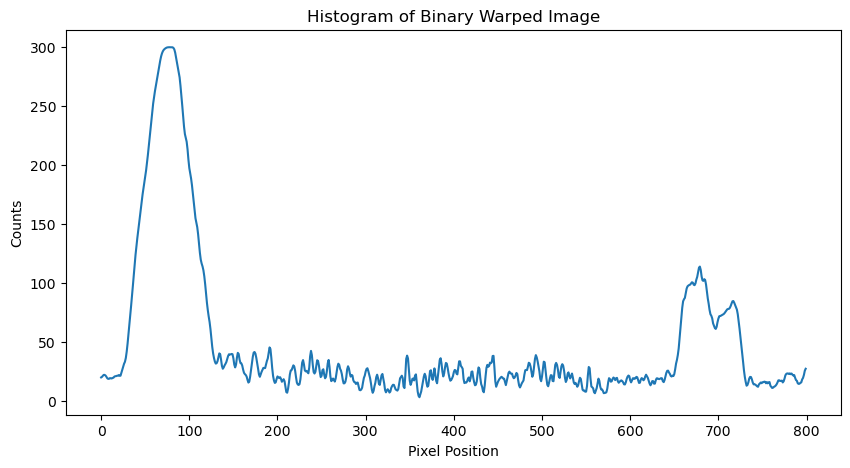

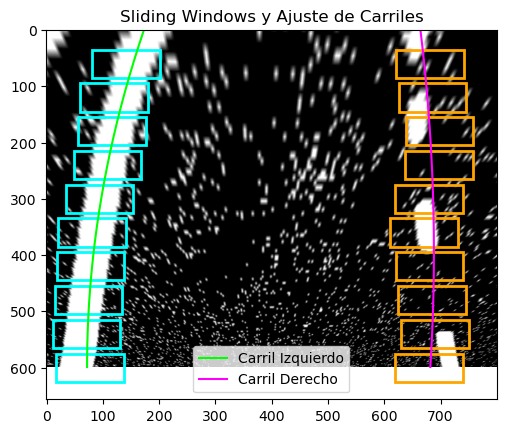

Ancho promedio del carril: 588.6


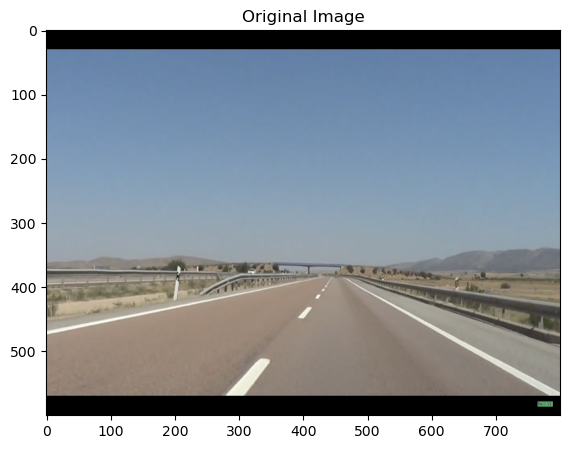

l_binary_lab
combined


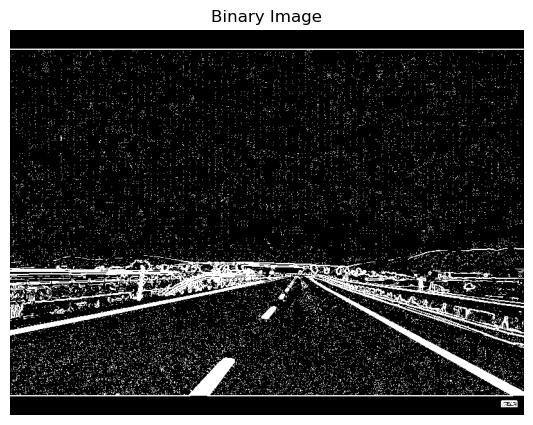

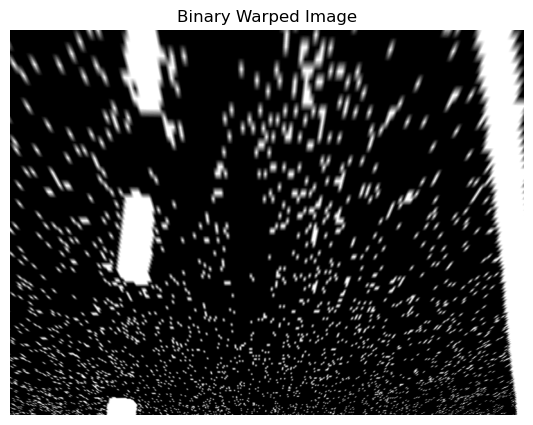

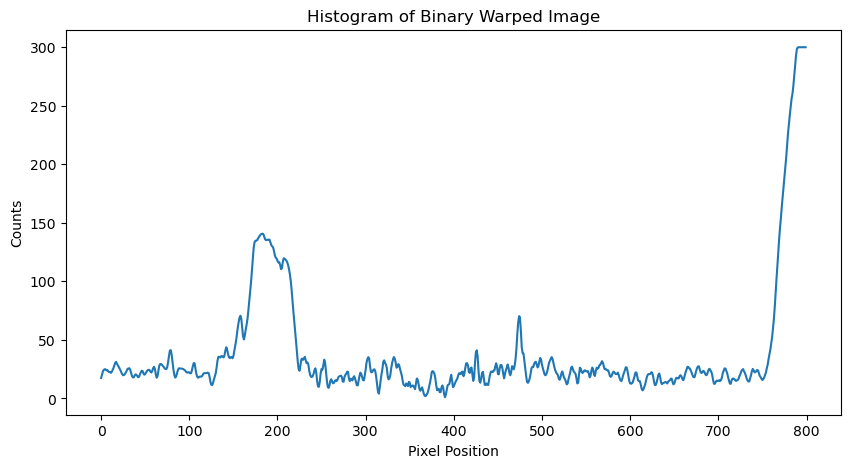

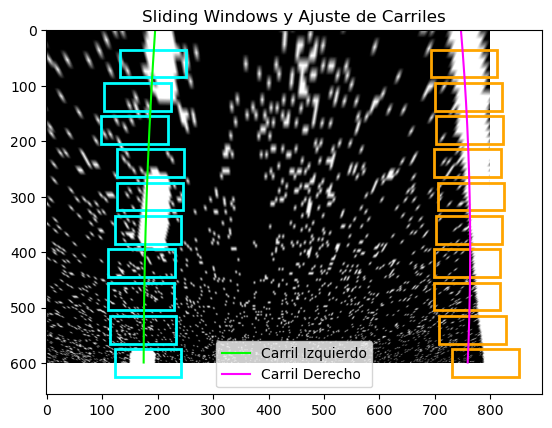

Ancho promedio del carril: 586.6


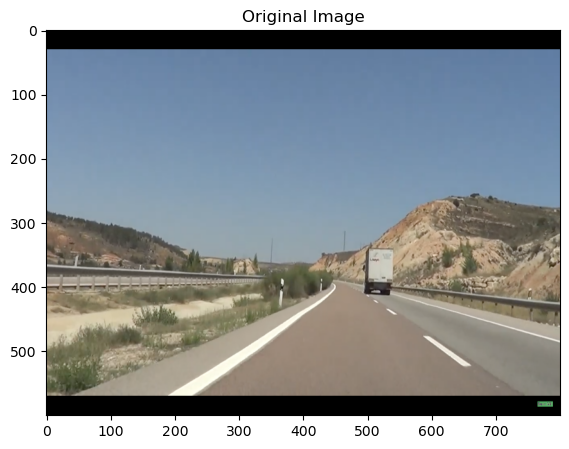

l_binary_lab
combined


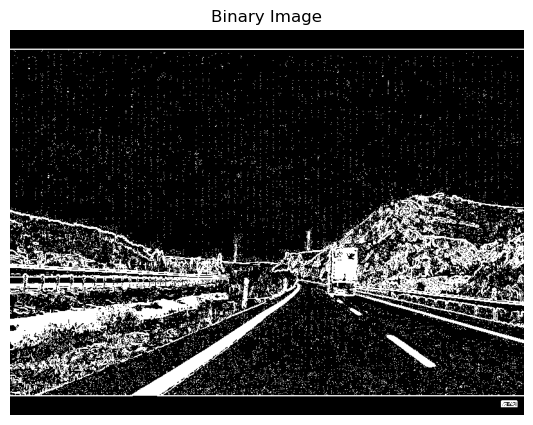

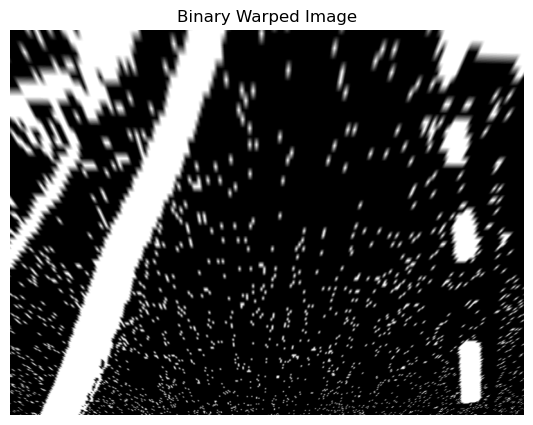

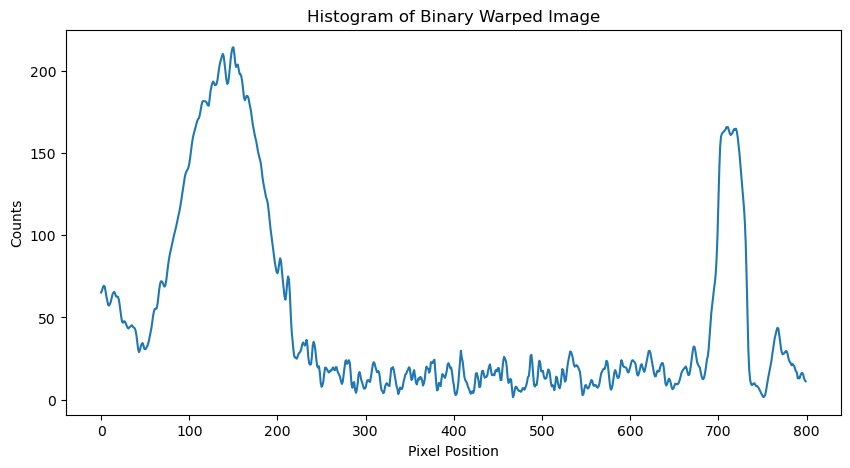

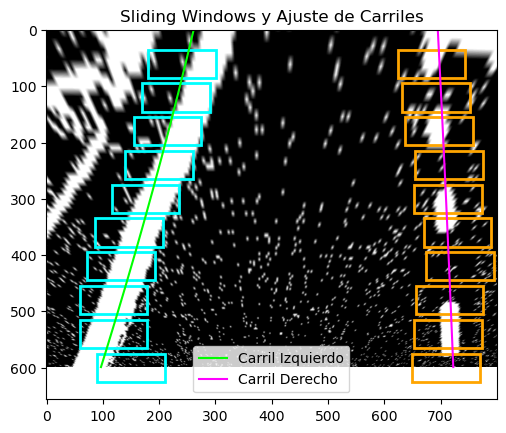

Ancho promedio del carril: 537.7


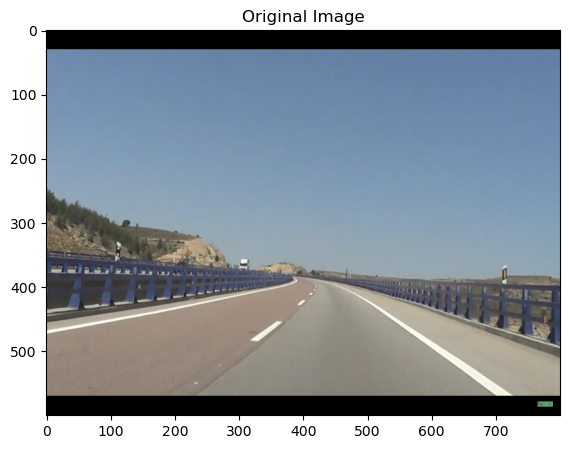

l_binary_lab
combined


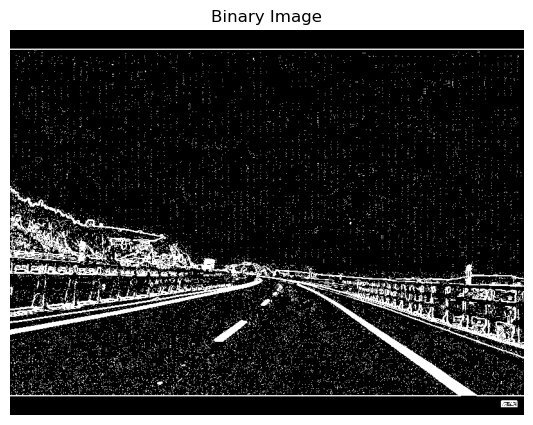

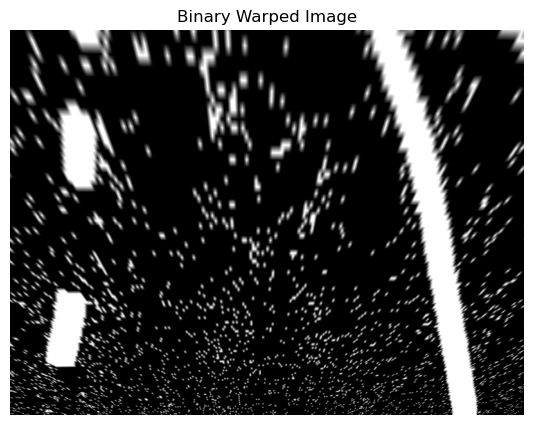

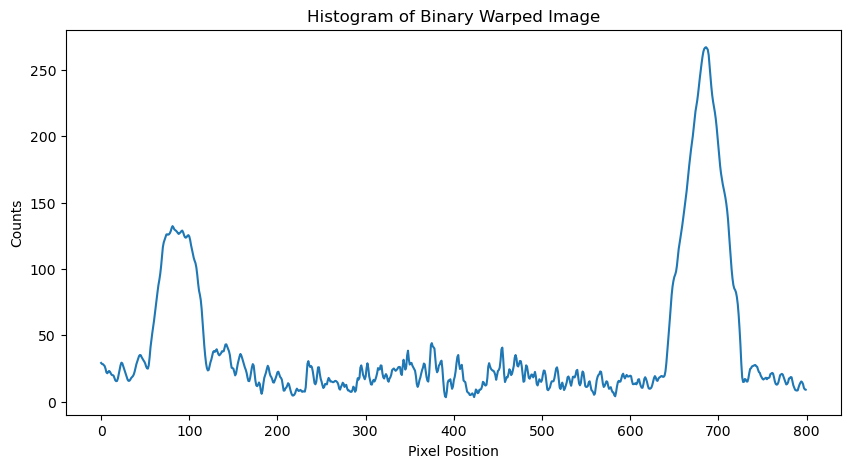

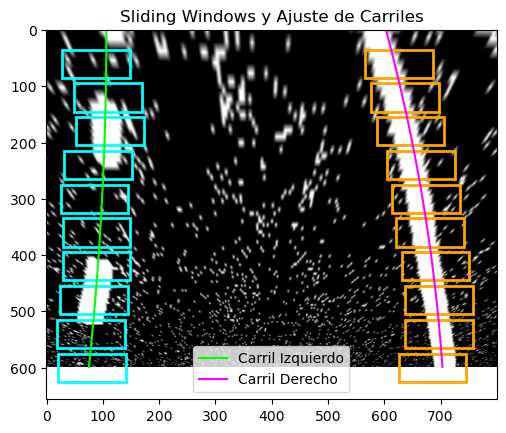

Ancho promedio del carril: 579.3


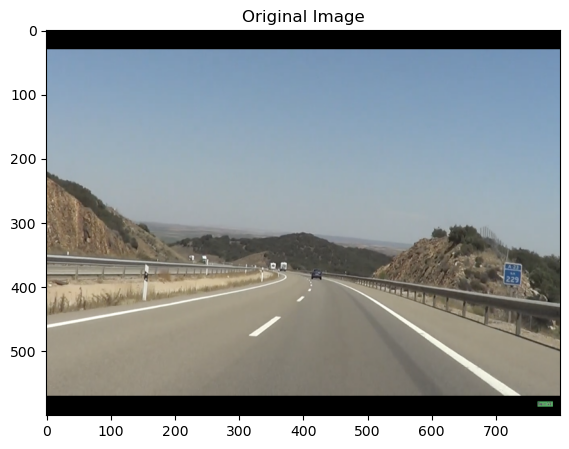

l_binary_lab
combined


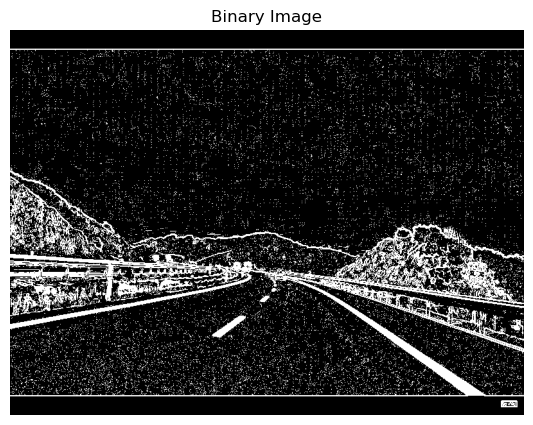

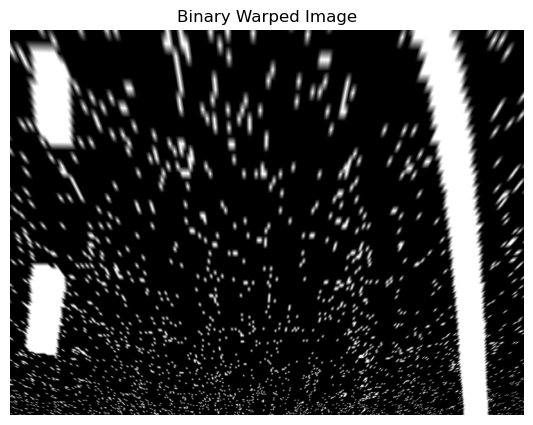

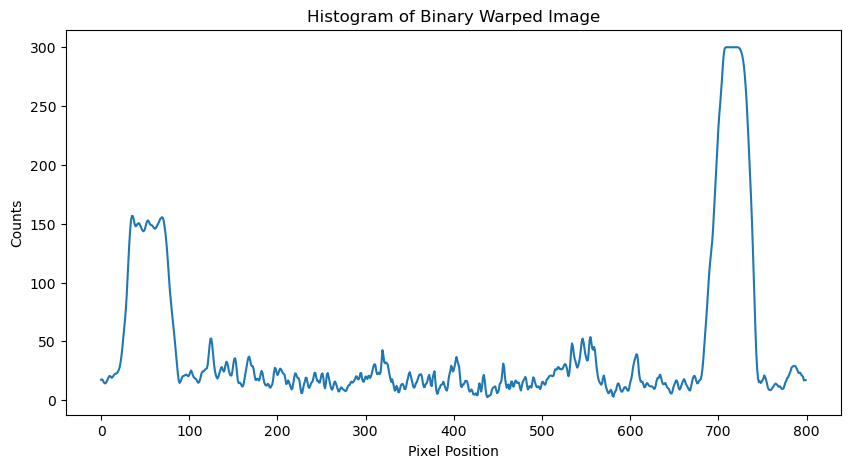

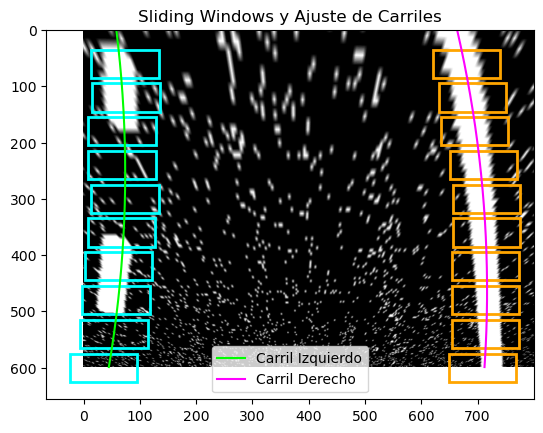

Ancho promedio del carril: 642.5


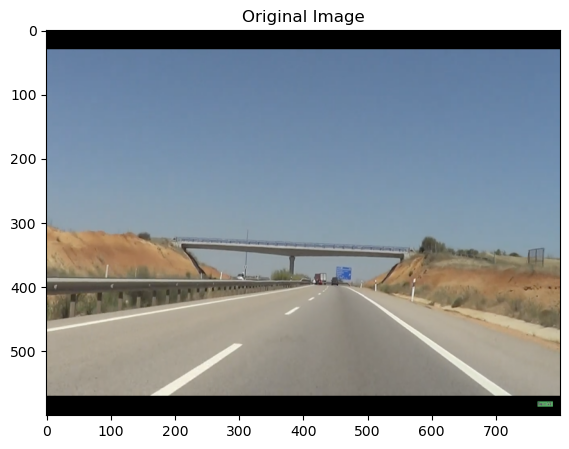

l_binary_lab
combined


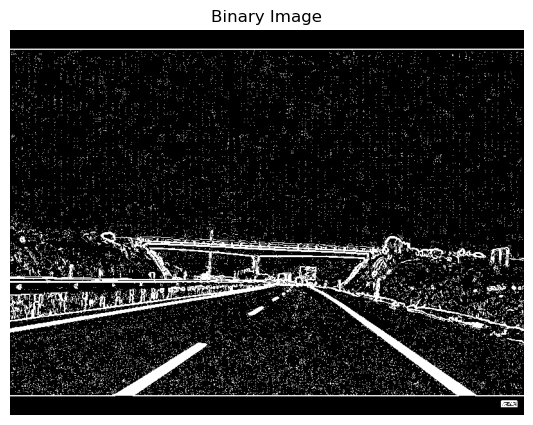

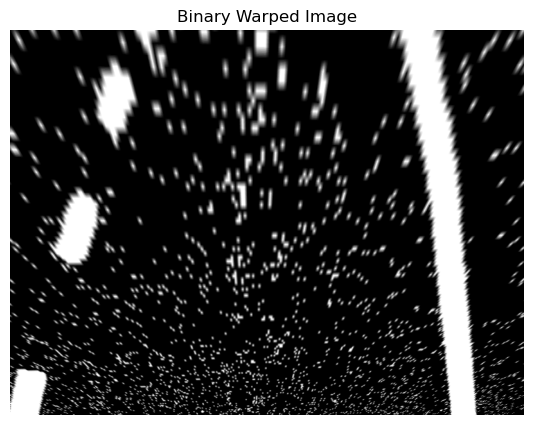

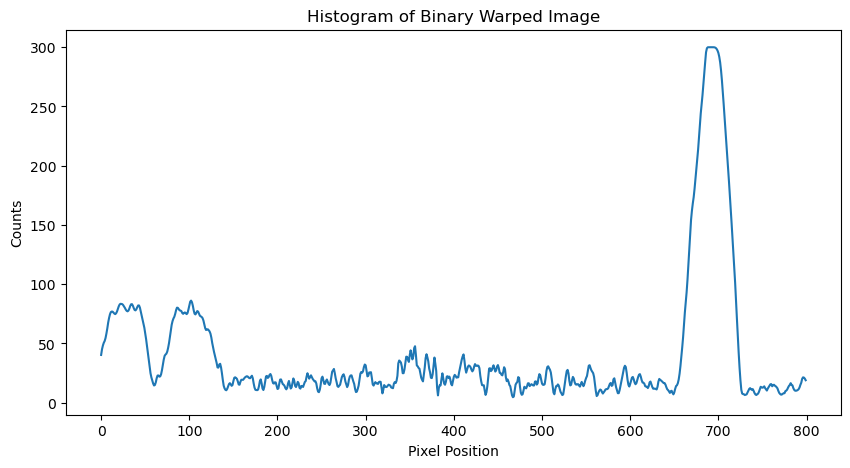

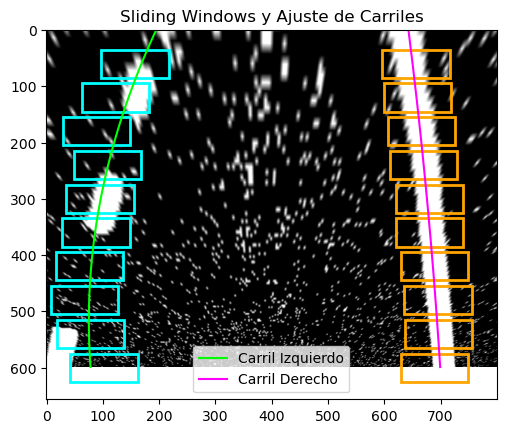

Ancho promedio del carril: 579.8


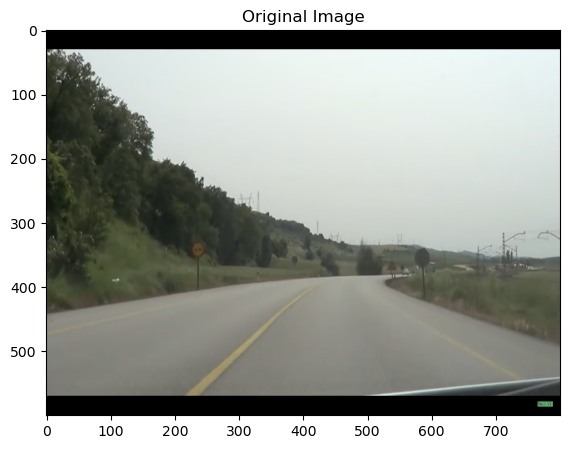

l_binary_lab
combined


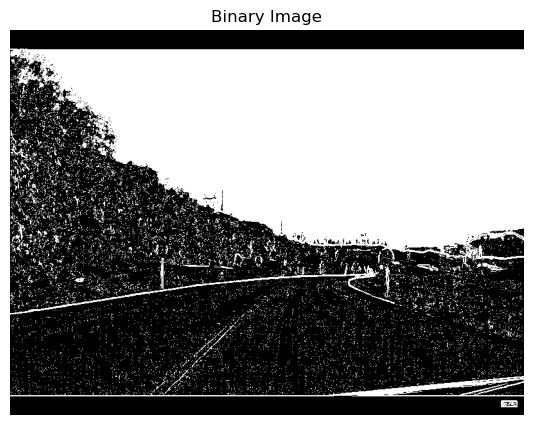

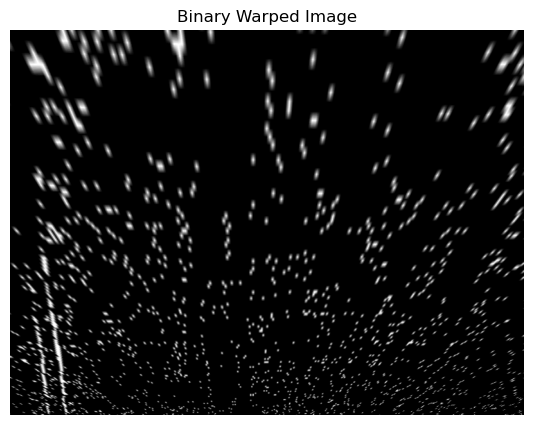

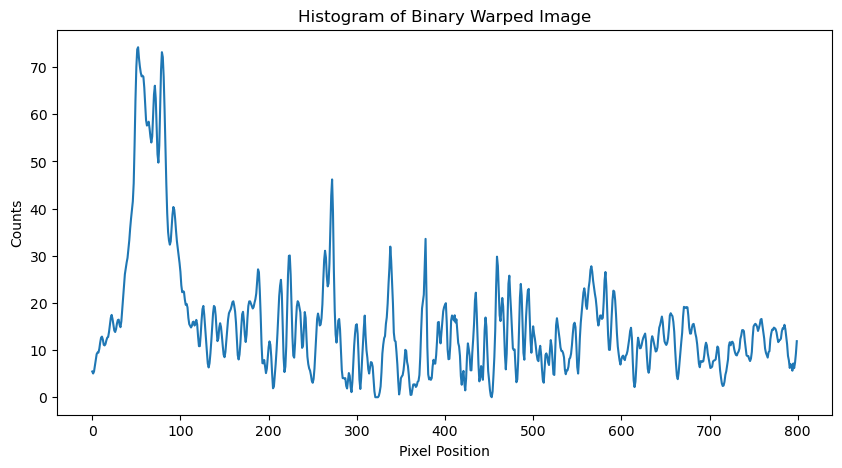

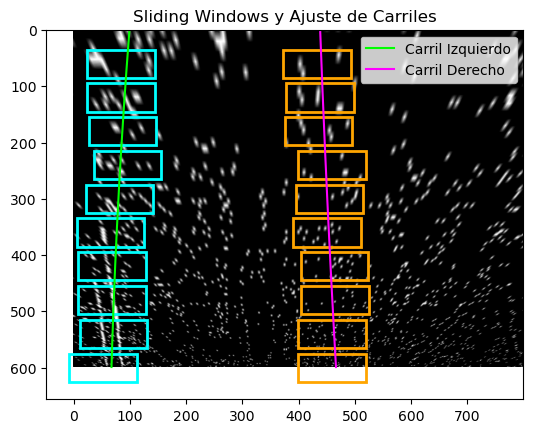

Ancho promedio del carril: 375.9


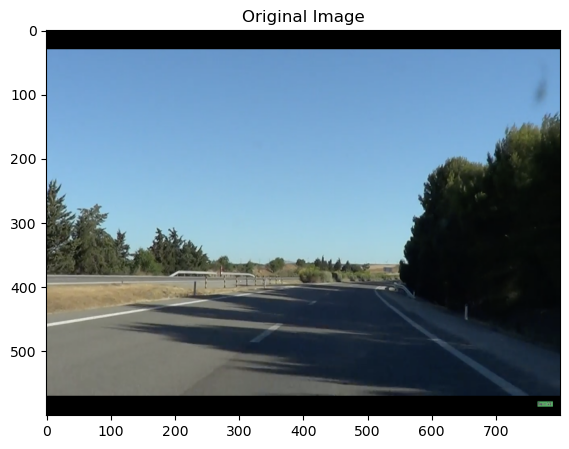

l_binary_lab
combined


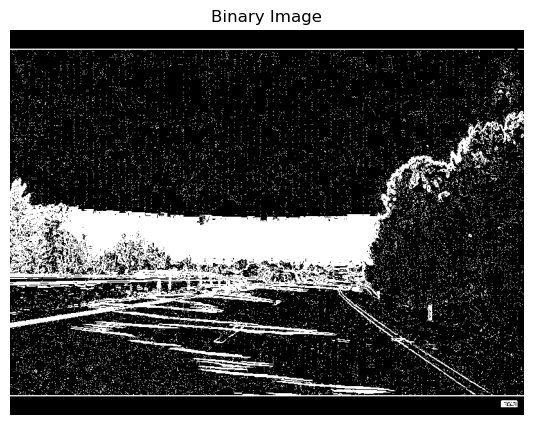

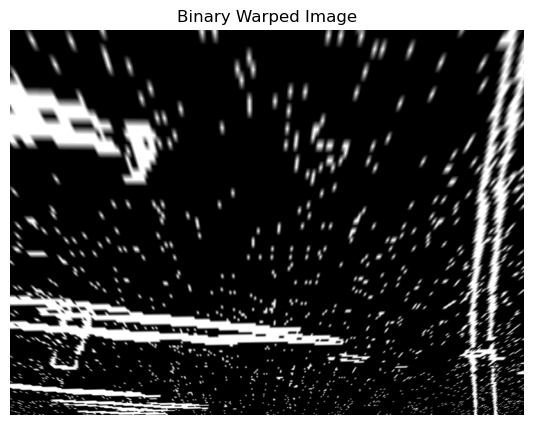

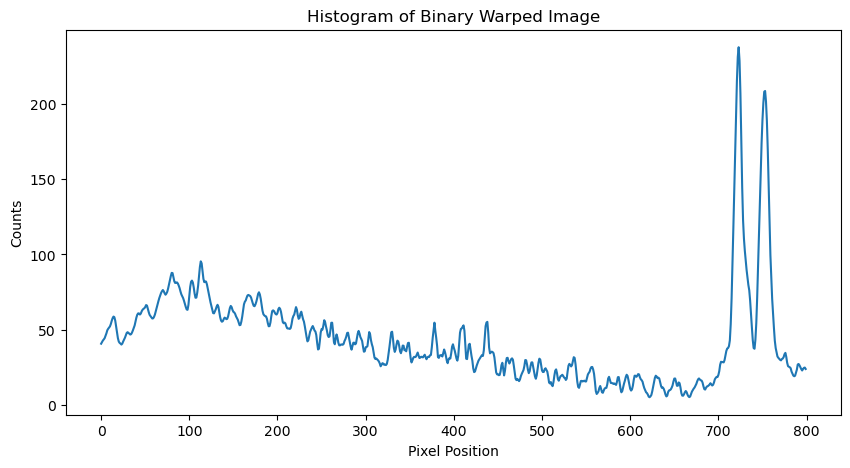

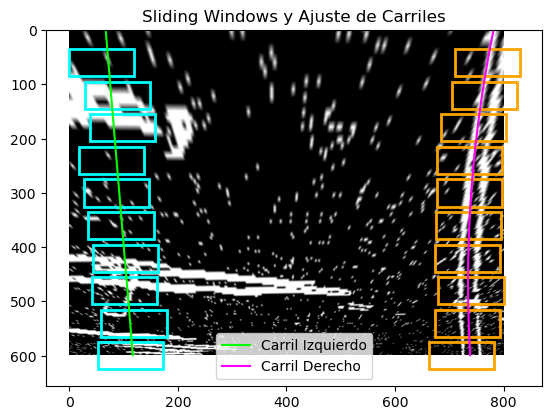

Ancho promedio del carril: 648.1


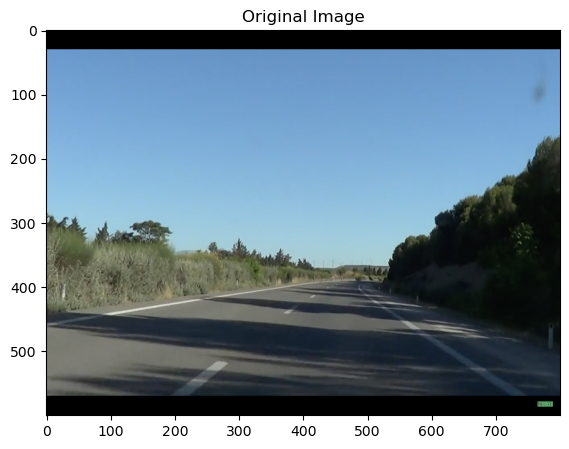

l_binary_lab
combined


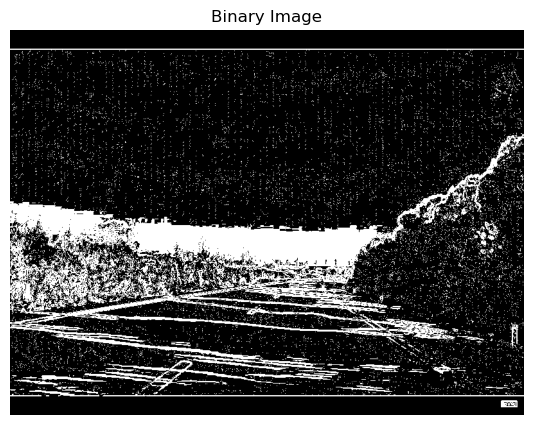

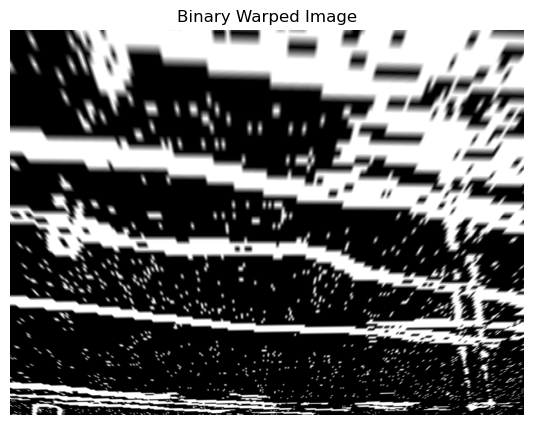

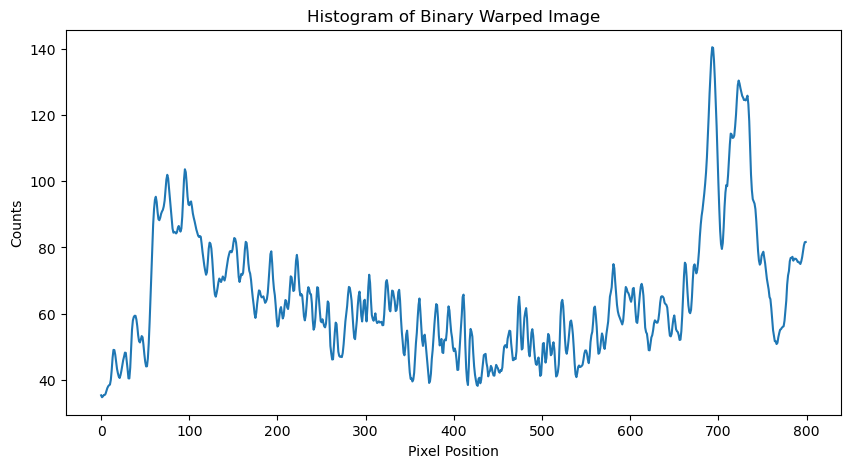

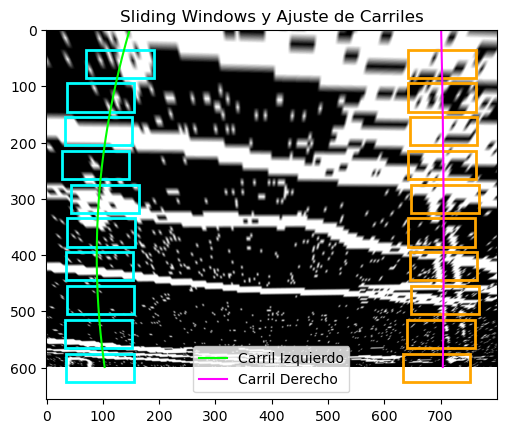

Ancho promedio del carril: 604.8


In [186]:
def scale_roi_points(roi_points, original_size, new_size):
    """
    Escala los puntos de la ROI para ajustarlos a la nueva resolución de la imagen.
    
    Parameters:
        roi_points: Puntos de la ROI en la imagen original.
        original_size: Tamaño original de la imagen (ancho, alto).
        new_size: Tamaño nuevo de la imagen (ancho, alto).
    
    Returns:
        roi_points_scaled: Puntos de la ROI ajustados a la nueva resolución.
    """
    scale_x = new_size[0] / original_size[0]
    scale_y = new_size[1] / original_size[1]
    
    roi_points_scaled = roi_points * [scale_x, scale_y]
    return roi_points_scaled

# Asumiendo que ya tienes el código para cargar las imágenes y que `roi_points` es un array de puntos que defines.

for image in images: 
    # Downsample the image
    image_size_og = (image.shape[1], image.shape[0])   
    image = cv2.resize(image, (800,600))  # Resize the image to a bigger resolution 
    
    # Show the image
    plt.figure(figsize=(10, 5))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Original Image")
    plt.show()

    binary = combined_gradient(image)

    # Show the binary image
    plt.figure(figsize=(10, 5))
    plt.imshow(binary, cmap='gray')
    plt.title("Binary Image")
    plt.axis('off')
    plt.show()

    # Get the new roi points scaled to the new image size
    roi_points_scaled = scale_roi_points(roi_points, image_size_og, (800,600))

    # Apply perspective transform with the scaled ROI points
    binary_warped, dst, src = apply_perspective_transform(binary, roi_points_scaled)

    # Show the binary warped image
    plt.figure(figsize=(10, 5))
    plt.imshow(binary_warped, cmap='gray')
    plt.title("Binary Warped Image")
    plt.axis('off')
    plt.show()

    histogram = calculate_histogram(binary_warped)


    left_base, right_base = find_lane_base(histogram)
    # plot the histogram
    plt.figure(figsize=(10, 5))
    plt.plot(histogram)
    plt.title("Histogram of Binary Warped Image")
    plt.xlabel("Pixel Position")
    plt.ylabel("Counts")
    plt.show()


    left_fit, right_fit, left_indices, right_indices, windows = perform_sliding_window(binary_warped, left_base, right_base, num_windows=10, window_margin=80, min_pixels=150)
    visualize_results(binary_warped, left_fit, right_fit, windows)
    lane_width = measure_lane_width(windows)
    print("Ancho promedio del carril:", lane_width)



In [216]:
# save data and do a process_image function to rescale the image

import pickle

# Save the ROI points and the resolutoin of the image
data = {
    'roi_points': roi_points_scaled,
    'image_size': (800, 600)
}

with open('data/roi_data.pkl', 'wb') as f:
    pickle.dump(data, f)


def downsample_image(image):
    # Downsample the image
    image_size_og = (image.shape[1], image.shape[0])   
    image = cv2.resize(image, (800,600))  # Resize the image to a bigger resolution 
    
    if os.path.exists('data/roi_data.pkl'):
        with open('data/roi_data.pkl', 'rb') as f:
            data = pickle.load(f)
            roi_points = data['roi_points']
            image_size_og = data['image_size']
    else:
        print("No se encontró el archivo de datos de ROI. Asegúrate de haberlo guardado previamente.")
        return


    roi_points_scaled = scale_roi_points(roi_points, image_size_og, (800,600))

    return image, roi_points_scaled





### Detect Right and Left Turns 

l_binary_lab
combined


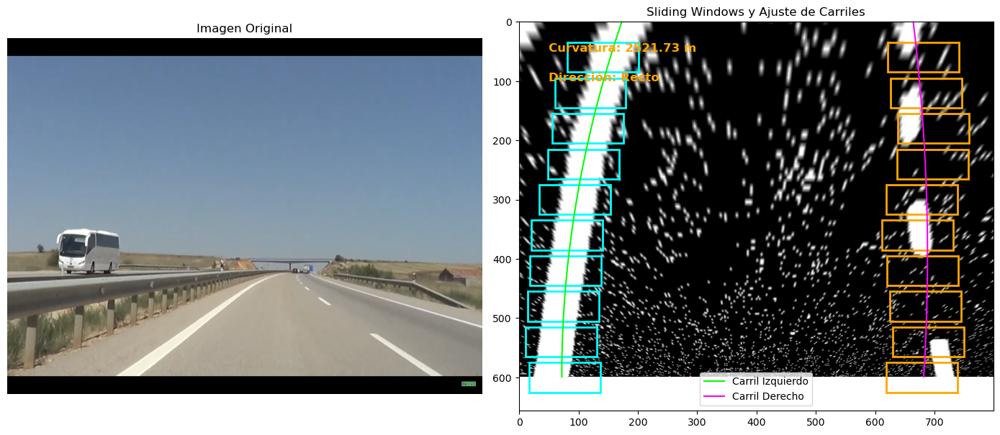

Ancho promedio del carril: 588.6
l_binary_lab
combined


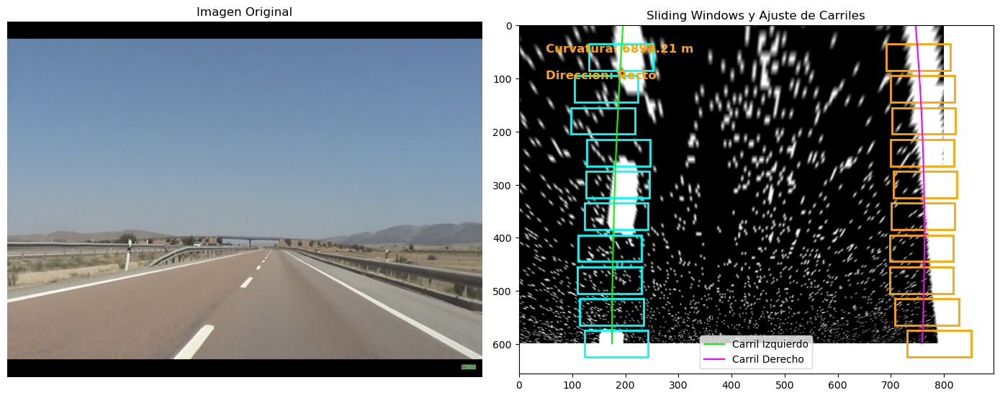

Ancho promedio del carril: 586.6
l_binary_lab
combined


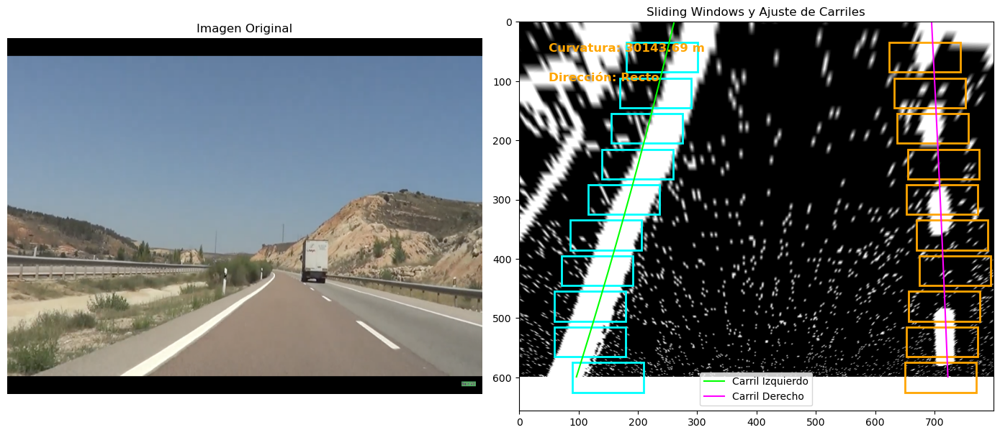

Ancho promedio del carril: 537.7
l_binary_lab
combined


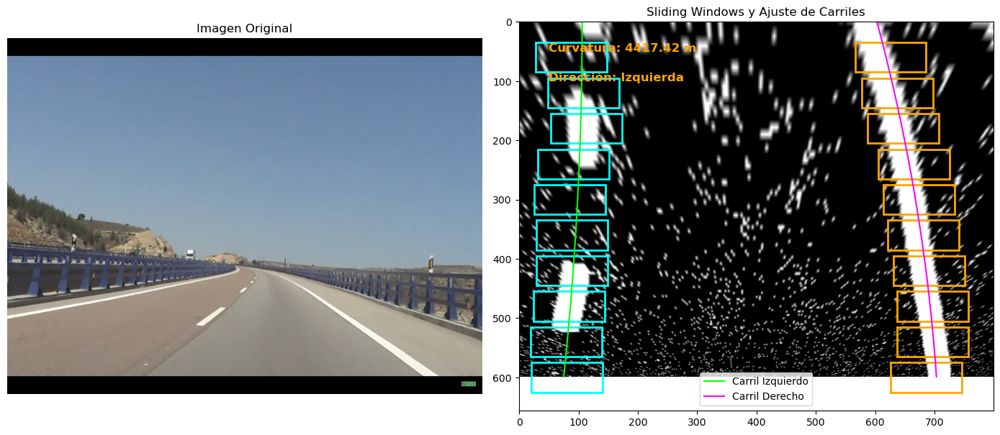

Ancho promedio del carril: 579.3
l_binary_lab
combined


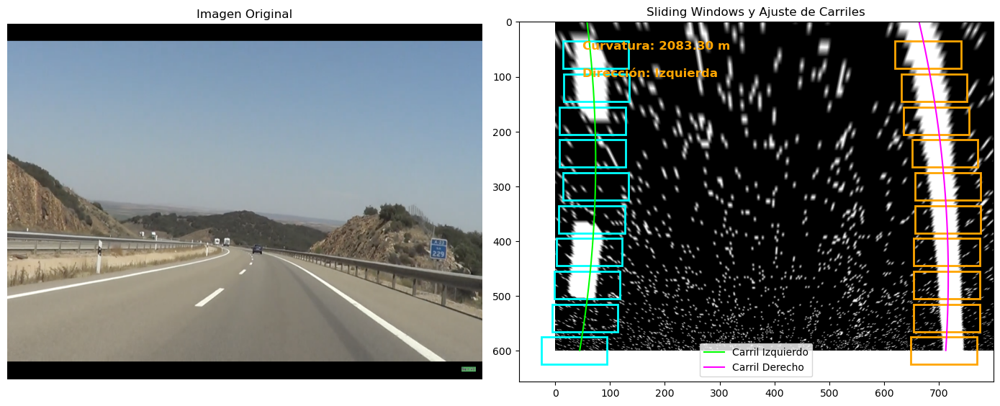

Ancho promedio del carril: 642.5
l_binary_lab
combined


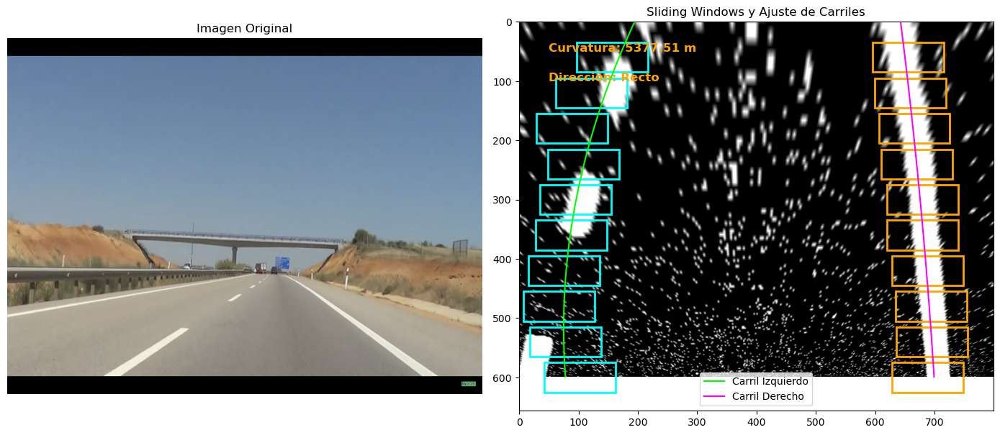

Ancho promedio del carril: 579.8
l_binary_lab
combined


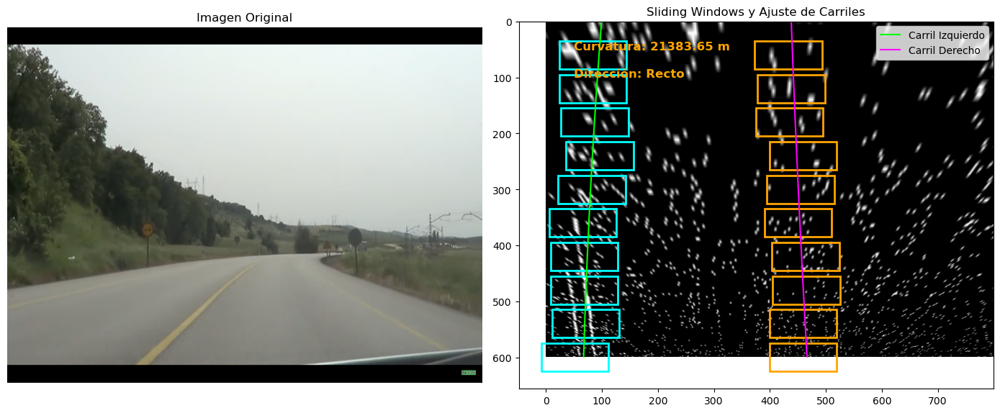

Ancho promedio del carril: 375.9
l_binary_lab
combined


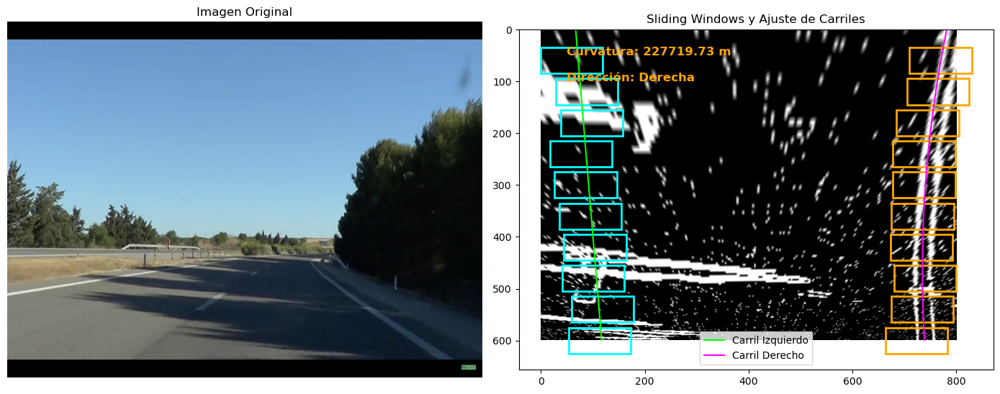

Ancho promedio del carril: 648.1
l_binary_lab
combined


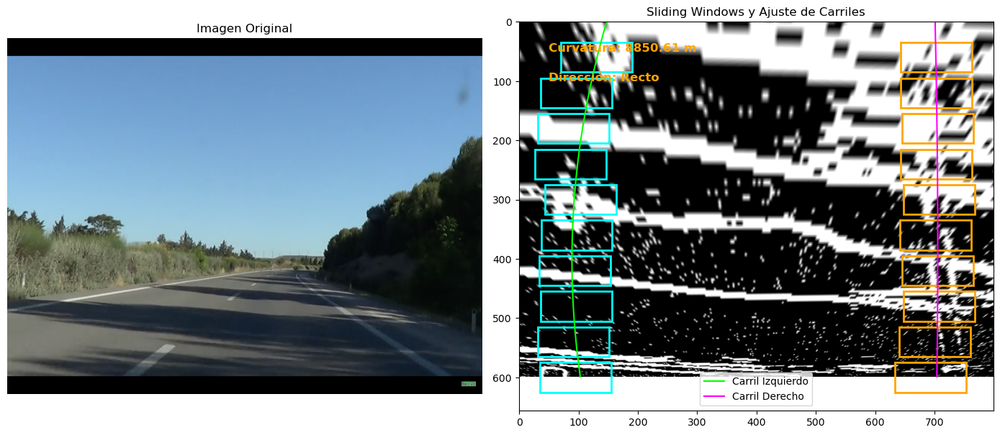

Ancho promedio del carril: 604.8


In [215]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def calculate_curvature(left_fit, right_fit, y_eval):
    """
    Calcula el radio de curvatura de los carriles izquierdo y derecho.
    
    Parameters:
        left_fit, right_fit: Polinomios ajustados para los carriles izquierdo y derecho.
        y_eval: La posición y (en píxeles) en la que se calcula la curvatura (generalmente en el fondo de la imagen).
        
    Returns:
        left_curvature, right_curvature: Radios de curvatura de los carriles izquierdo y derecho.
    """
    # Coeficientes de los polinomios para el carril izquierdo y derecho
    A_left, B_left, C_left = left_fit
    A_right, B_right, C_right = right_fit
    
    # Calculamos el radio de curvatura usando la fórmula
    left_curvature = ((1 + (2 * A_left * y_eval + B_left) ** 2) ** 1.5) / np.abs(2 * A_left)
    right_curvature = ((1 + (2 * A_right * y_eval + B_right) ** 2) ** 1.5) / np.abs(2 * A_right)
    
    return left_curvature, right_curvature

def detect_car_direction(left_fit, right_fit):
    """
    Detecta si el coche está yendo recto, girando a la izquierda o girando a la derecha.
    
    Parameters:
        left_fit, right_fit: Polinomios ajustados para los carriles izquierdo y derecho.
    
    Returns:
        direction: Dirección del coche ("Recto", "Izquierda", "Derecha").
    """
    # Comprobar si los coeficientes A de los polinomios son cercanos a cero
    A_left, _, _ = left_fit
    A_right, _, _ = right_fit
    
    if np.abs(A_left) < 0.0001 and np.abs(A_right) < 0.0001:
        direction = "Recto"
    elif A_left > 0 and A_right > 0:
        direction = "Derecha"
    elif A_left < 0 and A_right < 0:
        direction = "Izquierda"
    else:
        direction = "Recto"
    
    return direction


def visualize_results_with_curvature(binary_image, left_fit, right_fit, window_coords, y_eval, original_image):
    """
    Dibuja las ventanas del sliding window, los polinomios ajustados y los radios de curvatura,
    junto con la imagen original.
    
    Parameters:
        binary_image: Imagen binaria de entrada.
        left_fit, right_fit: Coeficientes de los polinomios ajustados.
        window_coords: Coordenadas de las ventanas del sliding window.
        y_eval: Posición y (en píxeles) en la que se calcula la curvatura.
        original_image: Imagen original de entrada.
    """
    y_vals = np.linspace(0, binary_image.shape[0] - 1, binary_image.shape[0])
    x_left_fit = x_right_fit = None

    if left_fit is not None:
        x_left_fit = left_fit[0] * y_vals ** 2 + left_fit[1] * y_vals + left_fit[2]
    if right_fit is not None:
        x_right_fit = right_fit[0] * y_vals ** 2 + right_fit[1] * y_vals + right_fit[2]

    # Crear figura con 2 subgráficas (una para la imagen original y otra para la imagen procesada)
    fig, ax = plt.subplots(1, 2, figsize=(14, 7))

    # Mostrar la imagen original en la primera subgráfica
    ax[0].imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    ax[0].set_title("Imagen Original")
    ax[0].axis('off')  # Ocultar ejes

    # Mostrar la imagen binaria procesada en la segunda subgráfica
    ax[1].imshow(binary_image, cmap='gray')
    
    # Dibujar ventanas
    for (left, right) in window_coords:
        left_rect = plt.Rectangle((left[0] - 60, left[1] - 25), 120, 50, edgecolor='cyan', fill=False, linewidth=2)
        right_rect = plt.Rectangle((right[0] - 60, right[1] - 25), 120, 50, edgecolor='orange', fill=False, linewidth=2)
        ax[1].add_patch(left_rect)
        ax[1].add_patch(right_rect)
    
    # Dibujar polinomios ajustados
    if x_left_fit is not None:
        ax[1].plot(x_left_fit, y_vals, color='lime', label='Carril Izquierdo')
    if x_right_fit is not None:
        ax[1].plot(x_right_fit, y_vals, color='magenta', label='Carril Derecho')
    
    # Calcular los radios de curvatura
    left_curvature, right_curvature = calculate_curvature(left_fit, right_fit, y_eval)
    direction = detect_car_direction(left_fit, right_fit)

    # Radio de curvatura global
    global_curvature = (left_curvature + right_curvature) / 2
    curvature_text = f"Curvatura: {global_curvature:.2f} m"
    direction_text = f"Dirección: {direction}"

    ax[1].set_title("Sliding Windows y Ajuste de Carriles")
    ax[1].legend()
    ax[1].text(50, 50, curvature_text, color='orange', fontsize=12, fontweight='bold')
    ax[1].text(50, 100, direction_text, color='orange', fontsize=12, fontweight='bold')

    plt.tight_layout()  # Ajustar el espacio entre subgráficas
    plt.show()

for image in images:
    image, roi_points_scaled = downsample_image(image)
    binary = combined_gradient(image)
    binary_warped, dst, src = apply_perspective_transform(binary, roi_points_scaled)
    histogram = calculate_histogram(binary_warped)
    left_base, right_base = find_lane_base(histogram)
    left_fit, right_fit, left_indices, right_indices, windows = perform_sliding_window(binary_warped, left_base, right_base, num_windows=10, window_margin=80, min_pixels=150)
    visualize_results_with_curvature(binary_warped, left_fit, right_fit, windows, binary_warped.shape[0] - 1, image)
    lane_width = measure_lane_width(windows)
    print("Ancho promedio del carril:", lane_width)






Now that we have all the project done in photos, we will create a video pipeline to process the video. We will use the same techniques that we used in the photos, but we will use the video frames as input. We will use the same techniques to find the lane in the video frames and we will use the polynomial that we found to draw the lane on the video frames.

In [222]:
# Comprobar que la regio de interes es correcta
# Read the image
video = cv2.VideoCapture('data/test_video/TEST_1080.mov')
ret, frame = video.read()

# mostrar un video con la region de interes seleccionada
while ret:
    frame, roi_points_scaled = downsample_image(frame)
    binary = combined_gradient(frame)
    binary_warped, dst, src = apply_perspective_transform(binary, roi_points_scaled)
    cv2.imshow('ROI', binary_warped)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
    ret, frame = video.read()

video.release()
cv2.destroyAllWindows()






l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_lab
combined
l_binary_l

KeyboardInterrupt: 

Video: 1920x1200 a 58.534351145038165 FPS
l_binary_lab
combined


OpenCV: FFMPEG: tag 0x5634504d/'MP4V' is not supported with codec id 12 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


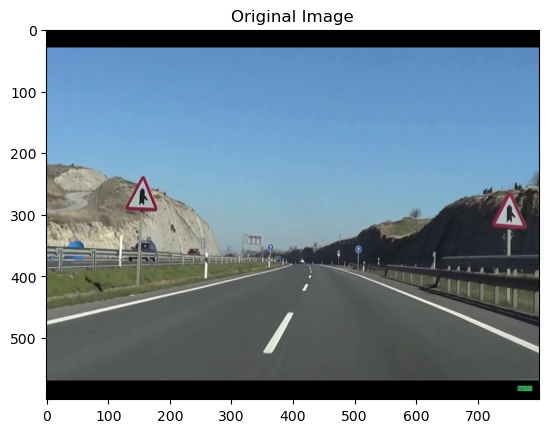

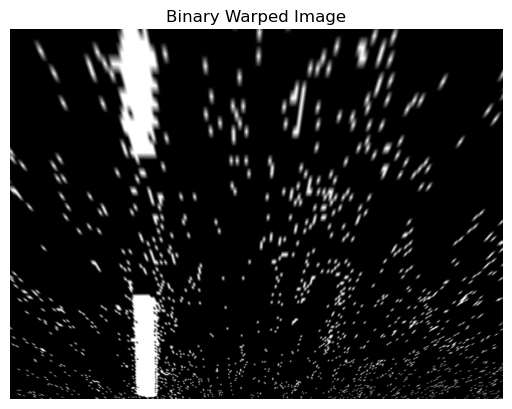

Curvatura: 1927.33 m
Dirección: Recto


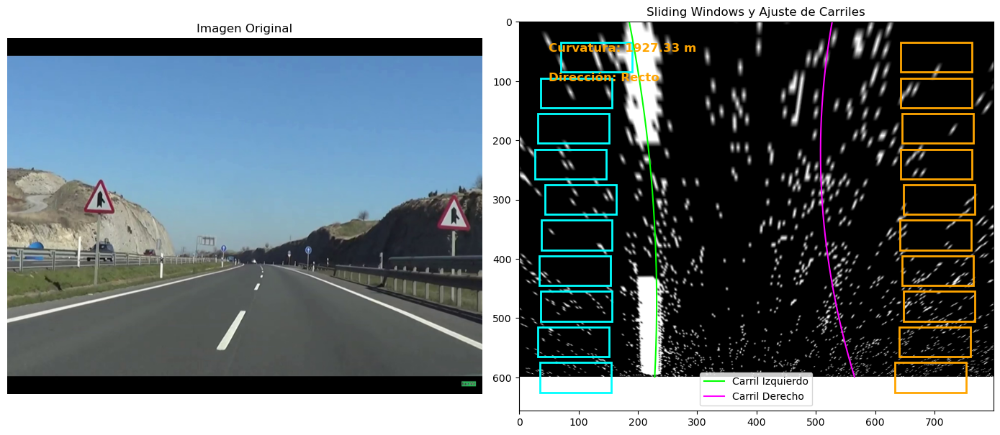

error: OpenCV(4.10.0) /Users/runner/work/opencv-python/opencv-python/opencv/modules/core/src/copy.cpp:71: error: (-215:Assertion failed) cn <= 4 in function 'scalarToRawData'


In [225]:
def process_frame(image):
    """
    Procesa un fotograma del video: aplica la detección de carriles y dibuja la información de la curvatura y dirección.
    
    Parameters:
        image: Fotograma de video a procesar.
        
    Returns:
        result: Fotograma procesado con la información de los carriles y texto sobre la curvatura y dirección.
    """
    # Obtener la imagen binarizada y transformada
    image, roi_points_scaled = downsample_image(image) # Escalar la imagen y los puntos de la ROI
    binary = combined_gradient(image)
    binary_warped, dst, src = apply_perspective_transform(binary, roi_points_scaled)

    # show original image
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Original Image")
    plt.show()
    

    # Calcular el histograma y las bases de los carriles
    histogram = calculate_histogram(binary_warped)
    left_base, right_base = find_lane_base(histogram)

    left_fit, right_fit, _, _, _ = perform_sliding_window(binary_warped, left_base, right_base,num_windows=10, window_margin=80, min_pixels=150)

    # show the binary warped image
    plt.imshow(binary_warped, cmap='gray')
    plt.title("Binary Warped Image")
    plt.axis('off')
    plt.show()
    

    # Calcular curvatura y dirección
    left_curvature, right_curvature = calculate_curvature(left_fit, right_fit, binary_warped.shape[0] - 1)
    direction = detect_car_direction(left_fit, right_fit)
    global_curvature = (left_curvature + right_curvature) / 2
    curvature_text = f"Curvatura: {global_curvature:.2f} m"
    direction_text = f"Dirección: {direction}"
    print(curvature_text)
    print(direction_text)



    # Crear la imagen de los carriles sobre la original
    ploty = np.linspace(0, binary_warped.shape[0] - 1, binary_warped.shape[0])
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2] if left_fit is not None else []
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2] if right_fit is not None else []

    warp_zero = np.zeros_like(image).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # visualize_results_with_curvature
    visualize_results_with_curvature(binary_warped, left_fit, right_fit, windows, binary_warped.shape[0] - 1, image)

    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))  # Carril en verde

    # Transformación inversa para volver a la perspectiva original
    Minv = cv2.getPerspectiveTransform(dst, src)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0]))
    
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)

    # Añadir textos sobre la imagen original
    cv2.putText(result, curvature_text, (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 255), 2, cv2.LINE_AA)
    cv2.putText(result, direction_text, (50, 100), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 255), 2, cv2.LINE_AA)

    return result



def process_video(input_video_path, output_video_path):
    # Cargar el video
    cap = cv2.VideoCapture(input_video_path)

    # Obtener información sobre el video
    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    print(f"Video: {width}x{height} a {fps} FPS")
    
    
    # Crear un objeto VideoWriter para guardar el video procesado
    fourcc = cv2.VideoWriter_fourcc(*'MP4V')  # O usa 'MP4V' para mp4
    out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))
    
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        
        # Procesar el fotograma
        processed_frame = process_frame(frame)
        
        # Escribir el fotograma procesado en el video de salida
        out.write(processed_frame)
    
    # Liberar recursos
    cap.release()
    out.release()

# Uso del pipeline
input_video = 'data/test_video/TEST_1080.mov'  # Ruta del video de entrada
output_video = 'output_video.mp4'  # Ruta del video de salida

process_video(input_video, output_video)
